In [1]:
import numpy as np
from shapely import wkt

from business_models import hahn, greenplum

import statsmodels.api as sm

import pandas as pd

from shapely.geometry import Point,Polygon

from shapely.geometry import shape

import folium

# from cartoframes.viz import Map, Layer, color_continuous_style, palettes, histogram_widget

import numpy as np
import geopandas as gpd

# from cartoframes.viz import color_category_style, color_bins_style, popup_element, size_bins_style

# from cartoframes.viz import  basic_widget , category_widget

from shapely.geometry import shape, GeometryCollection

import time



from matplotlib import pyplot as plt

/usr/local/lib/python3.7/dist-packages/geopandas/_compat.py:110: UserWarning: The Shapely GEOS version (3.8.0-CAPI-1.13.1 ) is incompatible with the GEOS version PyGEOS was compiled with (3.9.1-CAPI-1.14.2). Conversions between both will be slow.
  shapely_geos_version, geos_capi_version_string


In [2]:
from sklearn.linear_model import LogisticRegression as logreg

In [3]:
from sklearn.ensemble import RandomForestRegressor 

from sklearn.ensemble import GradientBoostingRegressor

from sklearn.model_selection import train_test_split

from sklearn.metrics import r2_score, mean_squared_error

from sklearn.tree import DecisionTreeRegressor as DTR

In [4]:
sample = greenplum('select * from analyst.iat_moscow_sample_fin_0205')

In [14]:
sample['month_order'].unique()

array(['2021-05-01T00:00:00.000000000', '2021-03-01T00:00:00.000000000',
       '2021-04-01T00:00:00.000000000'], dtype='datetime64[ns]')

In [16]:
# sample.groupby(['external_id','month_order'])['count_orders'].sum()[sample.groupby(['external_id','month_order'])['count_orders'].sum()==0]

sample=sample[~sample['external_id'].isin(['207723','91420','91452','91460','74051'])]

In [6]:
sample.groupby(['external_id','month_order'])['count_orders'].sum()[sample.groupby(['external_id','month_order'])['count_orders'].sum()==0]

Series([], Name: count_orders, dtype: float64)

In [7]:
sample.columns

Index(['month_order', 'external_id', 'hex_gid', 'lavka_exist_month',
       'ttl_pop_res', 'A_res', 'B1_res', 'B2_res', 'C1_res', 'C2_res',
       ...
       'Орехи, снеки, сухофрукты_hex', 'Пиццерия_hex',
       'Продуктовый гипермаркет_hex', 'Продуктовый рынок_hex', 'Ресторан_hex',
       'Спортбар_hex', 'Столовая_hex', 'Супермаркет_hex', 'Суши-бар_hex',
       'Универмаг_hex'],
      dtype='object', length=119)

In [8]:
sample['count_orders'].value_counts(normalize=True)

0.0       0.262023
1.0       0.039896
2.0       0.022344
3.0       0.015963
4.0       0.013215
            ...   
1026.0    0.000025
1299.0    0.000025
2527.0    0.000025
2519.0    0.000025
1416.0    0.000025
Name: count_orders, Length: 1447, dtype: float64

In [ ]:
###

In [2550]:
sample_train = sample[(sample['month_order']<'2021-05')&(sample['lavka_exist_month']>3)]

In [17]:
sample_valid = sample[(sample['month_order']=='2021-05-01')&(sample['lavka_exist_month']>3)]

In [18]:
sample_valid.shape

(12439, 119)

In [26]:
sample_valid

,month_order,external_id,hex_gid,lavka_exist_month,ttl_pop_res,A_res,B1_res,B2_res,C1_res,C2_res,...,"Орехи, снеки, сухофрукты_hex",Пиццерия_hex,Продуктовый гипермаркет_hex,Продуктовый рынок_hex,Ресторан_hex,Спортбар_hex,Столовая_hex,Супермаркет_hex,Суши-бар_hex,Универмаг_hex
0,2021-05-01,60287,8911aa785dbffff,26,564.51,0.93,16.74,110.67,361.77,72.54,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2021-05-01,60287,8911aa78427ffff,26,0.12,0.00,0.02,0.00,0.10,0.00,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2021-05-01,169093,8911aa78427ffff,12,0.00,0.00,0.00,0.00,0.00,0.00,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,2021-05-01,60287,8911aa78437ffff,26,99.00,0.00,3.30,21.12,61.71,11.88,...,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0
4,2021-05-01,60287,8911aa78553ffff,26,0.01,0.00,0.00,0.00,0.00,0.00,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13751,2021-05-01,190153,8911aa4d327ffff,10,18.86,0.00,0.46,8.28,9.66,0.46,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13752,2021-05-01,190153,8911aa4de43ffff,10,249.00,5.00,13.00,124.00,100.00,5.00,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13755,2021-05-01,95108,8911aa6aa33ffff,18,1.00,0.00,0.00,0.50,0.50,0.00,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13756,2021-05-01,95108,8911aa6aa27ffff,18,0.36,0.00,0.00,0.00,0.00,0.00,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [30]:
df_zones = greenplum(" select * from analyst.iat_lavki_zones_monthly where dt='2021-06-15' and cluster='Москва'")

In [32]:
df_lavka_stat = sample_valid.groupby(['external_id'])['ttl_pop_res','C1_res','C2_res','count_orders'].sum().join(
    sample_valid.groupby(['external_id'])['cte_mean','lavka_exist_month'].mean()
)#.to_csv('lavki_may_stat.csv')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  """Entry point for launching an IPython kernel.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  


In [35]:
df_zones[df_zones.columns[:3]].merge(df_lavka_stat, on ='external_id').to_csv('lavki_may_stat.csv')

In [1041]:
sample_train.shape

(24923, 119)

(array([2.3865e+04, 9.1700e+02, 1.1300e+02, 1.9000e+01, 4.0000e+00,
        2.0000e+00, 1.0000e+00, 0.0000e+00, 0.0000e+00, 2.0000e+00]),
 array([   0. ,  699.8, 1399.6, 2099.4, 2799.2, 3499. , 4198.8, 4898.6,
        5598.4, 6298.2, 6998. ]),
 <BarContainer object of 10 artists>)

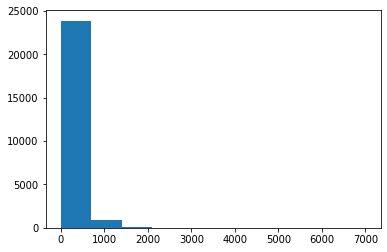

In [1042]:
plt.hist(sample_train['count_orders'])

In [23]:
sample_train.corr('spearman')['count_orders']

lavka_exist_month    0.250220
ttl_pop_res          0.855336
A_res                0.638402
B1_res               0.757376
B2_res               0.814882
                       ...   
Спортбар_hex         0.015446
Столовая_hex         0.051668
Супермаркет_hex      0.319319
Суши-бар_hex         0.094212
Универмаг_hex        0.023123
Name: count_orders, Length: 116, dtype: float64

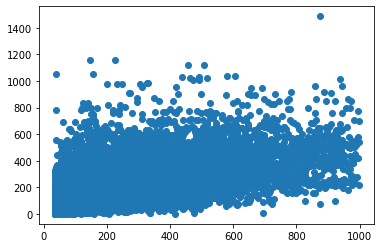

In [49]:
plt.scatter(sample_train[(sample_train['count_orders']<1000)&(sample_train['count_orders']>34)]['count_orders'],sample_train[(sample_train['count_orders']<1000)&(sample_train['count_orders']>34)]['C1_res'])

In [162]:
# sample_train=sample_train[sample_train['ttl_pop']>0]

In [163]:
np.percentile(sample_train['count_orders']/(sample_train['ttl_pop']+1), q=[25,30,50,75,95,99])

array([0.        , 0.024     , 0.14705882, 0.37903847, 1.01996517,
       2.34910775])

In [1043]:
sample_train['flg_0'] = (sample_train['count_orders']==0)*1

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [1044]:
sample_valid['flg_0'] = (sample_valid['count_orders']==0)*1

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [1045]:
sample_train['flg_0'].value_counts()

0    18336
1     6587
Name: flg_0, dtype: int64

In [2551]:
sample_train.columns.tolist()

['month_order',
 'external_id',
 'hex_gid',
 'lavka_exist_month',
 'ttl_pop_res',
 'A_res',
 'B1_res',
 'B2_res',
 'C1_res',
 'C2_res',
 '0_17_res',
 '18_24_res',
 '25_34_res',
 '35_44_res',
 '45_54_res',
 '55_99_res',
 'f_res',
 'm_res',
 '%_female_res',
 '%_C12_res',
 '%_2534',
 '%_3544',
 '%_2544',
 '%_4554',
 'ttl_pop_work',
 'A_work',
 'B1_work',
 'B2_work',
 'C1_work',
 'C2_work',
 '0_17_work',
 '18_24_work',
 '25_34_work',
 '35_44_work',
 '45_54_work',
 '55_99_work',
 'dist_lavka_by_samokat',
 'f_work',
 'm_work',
 '%_female_work',
 '%_C12_work',
 'ttl_pop',
 'count_orders',
 'flg_samokat_15m',
 'flg_lavka_15m',
 'cte_mean',
 'cte_std',
 'dist2samokat',
 'dist2lavki',
 'Бар безалкогольных напитков_6mbike',
 'Бар, паб_6mbike',
 'Бизнес-центр_6mbike',
 'Булочная, пекарня_6mbike',
 'Быстрое питание_6mbike',
 'Гипермаркет_6mbike',
 'Диетические и диабетические продукты_6mbike',
 'Кальян-бар_6mbike',
 'Кафе_6mbike',
 'Кондитерская_6mbike',
 'Кофейня_6mbike',
 'Магазин алкогольных нап

In [1049]:
test_log_y

30978    0
27856    0
27596    0
22830    0
37014    1
        ..
30921    1
21783    0
36683    1
21629    0
39014    0
Name: flg_0, Length: 7477, dtype: int64

In [349]:
from sklearn.metrics import roc_auc_score, precision_score, recall_score

In [1050]:
log = logreg(penalty = 'l1',C=0.0001, solver='liblinear')
log.fit(train_log_x, train_log_y)

print( roc_auc_score(log.predict(test_log_x),test_log_y)*2-1,
       precision_score(log.predict(test_log_x),test_log_y),
      recall_score(log.predict(test_log_x),test_log_y))

0.6819088747893476 0.8673780487804879 0.7326180257510729


In [1051]:
print( roc_auc_score(log.predict(train_log_x),train_log_y)*2-1,
       precision_score(log.predict(train_log_x),train_log_y),
      recall_score(log.predict(train_log_x),train_log_y))

0.6722042209788583 0.857761420220827 0.7269724770642202


In [1052]:
print( roc_auc_score(log.predict(sample_valid[train_log_x.columns]),sample_valid['flg_0'])*2-1,
       precision_score(log.predict(sample_valid[train_log_x.columns]),sample_valid['flg_0']),
      recall_score(log.predict(sample_valid[train_log_x.columns]),sample_valid['flg_0']))

0.633804062766693 0.8555417185554172 0.6887218045112782


In [551]:
train_x[['ttl_pop_res',  'dist2samokat', 'dist2lavki','ttl_pop_work']].corr()

,ttl_pop_res,dist2samokat,dist2lavki,ttl_pop_work
ttl_pop_res,1.000000,-0.199242,-0.340971,0.167248
dist2samokat,-0.199242,1.000000,0.277953,-0.107461
dist2lavki,-0.340971,0.277953,1.000000,-0.204860
ttl_pop_work,0.167248,-0.107461,-0.204860,1.000000


In [553]:
[(i,j) for i,j in zip(train_x.columns,log.coef_[0]) if abs(j)>0.0000]

[('ttl_pop_res', -0.015386502991340272),
 ('ttl_pop_work', -0.003751461976255087),
 ('dist2samokat', 7.548097978966725e-05),
 ('dist2lavki', 0.00033224936542441475)]

In [883]:
train_y

32159   -3.878673
20484   -1.196538
15983   -1.962105
27952    0.014614
17091   -0.243218
           ...   
23076   -3.061690
31055   -0.835463
23131   -2.249184
30207   -1.662301
20427   -3.305971
Name: target, Length: 12963, dtype: float64

In [1053]:
log = logreg(penalty = 'l1',C=0.0001, solver='liblinear')
log.fit(train_log_x[['ttl_pop_res',  'dist2samokat', 'dist2lavki','ttl_pop_work']], train_log_y)

print( roc_auc_score(log.predict(test_log_x[['ttl_pop_res',  'dist2samokat', 'dist2lavki','ttl_pop_work']]),test_log_y)*2-1,
       precision_score(log.predict(test_log_x[['ttl_pop_res',  'dist2samokat', 'dist2lavki','ttl_pop_work']]),test_log_y),
      recall_score(log.predict(test_log_x[['ttl_pop_res',  'dist2samokat', 'dist2lavki','ttl_pop_work']]),test_log_y))

0.6819088747893476 0.8673780487804879 0.7326180257510729


In [ ]:
# делим на 2 выборки: 0 и не 0 

In [2528]:
def prepare_train_test (sample_train,type = 'train'):
#     sample_train1,sample_train2 =sample_train[sample_train['count_orders']==0],sample_train[sample_train['count_orders']>0]

    sample_train['orders_by_pop'] =sample_train['count_orders']/(sample_train['ttl_pop']+1)

    print('min',sample_train['orders_by_pop'].min())
    
    sample_train['1']=1
    
#     
    
    sample_train['target'] = np.log(sample_train['orders_by_pop'].apply(lambda x: 0.0001 if x==0 else x))

    plt.hist(sample_train['target'])
    plt.show();
    
    X=sample_train[sample_train.columns[3:-1]].drop(['count_orders','orders_by_pop'], axis=1)
    
    
    
    X['flg_lavka_15m']=1*X['flg_lavka_15m']
    X['flg_samokat_15m']=1*X['flg_samokat_15m']
    
    cols_div = [ i for i in X.columns if '%' not in i and 'dist' not in i and 'flg'not in i and 'cte' not in i]
    
    for col in cols_div:
        try:
            if 'res' in col:
                X[col+'_by_all_res'] = X[col]/ (X['ttl_pop_res']+1)
            elif 'work' in col:
                X[col+'_by_all_work'] = X[col]/ (X['ttl_pop_work']+1)
            else:
                X[col+'_by_pop'] = X[col]/ (X['ttl_pop']+1)
        except:
            print(col)

    y=sample_train['target']
    
    drop_cols = (X==0).mean(axis=0)[(X==0).mean(axis=0)>=0.95].index
    
    X.drop(drop_cols,axis=1, inplace=True)
    
    if type =='train':
        train_x,  test_x,train_y, test_y = train_test_split(X,y, test_size=0.3)

        return train_x,  test_x,train_y, test_y 
    else:
        return X,y

In [85]:
# iqr = np.percentile(sample_train2['orders_by_pop'],75)-np.percentile(sample_train2['orders_by_pop'],25)
# top_boarder =np.percentile(sample_train2['orders_by_pop'],75)+3*iqr
# np.percentile(sample_train2['orders_by_pop'],75)

(array([  10.,   31.,  222., 1404., 5896., 9627., 6586., 1330.,  194.,
          37.]),
 array([-5.30907801, -4.38434205, -3.4596061 , -2.53487014, -1.61013419,
        -0.68539823,  0.23933772,  1.16407367,  2.08880963,  3.01354558,
         3.93828154]),
 <BarContainer object of 10 artists>)

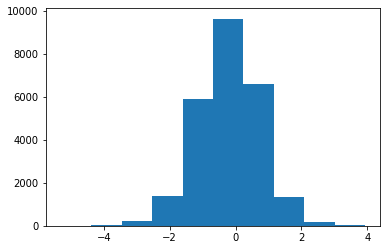

In [653]:
plt.hist(np.log(sample_train.dist_lavka_by_samokat))

In [2525]:
sample_train['dist_lavka_by_samokat'] = np.log(sample_train.dist_lavka_by_samokat)
sample_valid['dist_lavka_by_samokat'] = np.log(sample_valid.dist_lavka_by_samokat)

/usr/local/lib/python3.7/dist-packages/pandas/core/arraylike.py:358: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [2548]:
sample_train.columns.tolist()

['month_order',
 'external_id',
 'hex_gid',
 'lavka_exist_month',
 'ttl_pop_res',
 'A_res',
 'B1_res',
 'B2_res',
 'C1_res',
 'C2_res',
 '0_17_res',
 '18_24_res',
 '25_34_res',
 '35_44_res',
 '45_54_res',
 '55_99_res',
 'f_res',
 'm_res',
 '%_female_res',
 '%_C12_res',
 '%_2534',
 '%_3544',
 '%_2544',
 '%_4554',
 'ttl_pop_work',
 'A_work',
 'B1_work',
 'B2_work',
 'C1_work',
 'C2_work',
 '0_17_work',
 '18_24_work',
 '25_34_work',
 '35_44_work',
 '45_54_work',
 '55_99_work',
 'dist_lavka_by_samokat',
 'f_work',
 'm_work',
 '%_female_work',
 '%_C12_work',
 'ttl_pop',
 'count_orders',
 'flg_samokat_15m',
 'flg_lavka_15m',
 'cte_mean',
 'cte_std',
 'dist2samokat',
 'dist2lavki',
 'Бар безалкогольных напитков_6mbike',
 'Бар, паб_6mbike',
 'Бизнес-центр_6mbike',
 'Булочная, пекарня_6mbike',
 'Быстрое питание_6mbike',
 'Гипермаркет_6mbike',
 'Диетические и диабетические продукты_6mbike',
 'Кальян-бар_6mbike',
 'Кафе_6mbike',
 'Кондитерская_6mbike',
 'Кофейня_6mbike',
 'Магазин алкогольных нап

min 0.0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: h

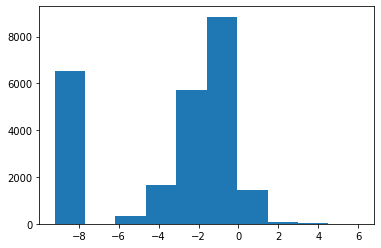

address
assortment_id
cluster
dt
ezones
group_id
price_list_id
print_id
samples
slug
source
status
store_id
title
user_id
geometry_zone
city
hex_gid_lavka
lavka_first_month
main_delivery_type
geometry_store
hex_gid_verify


In [2552]:
train_x,  test_x,train_y, test_y =  prepare_train_test (sample_train,type = 'train')

In [1094]:
train_y.shape

(12835,)

min 0.0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: h

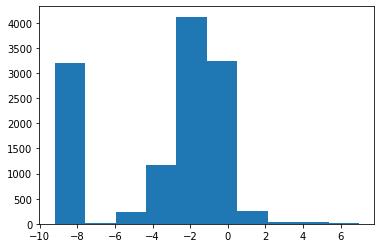

address
assortment_id
cluster
dt
ezones
group_id
price_list_id
print_id
samples
slug
source
status
store_id
title
user_id
geometry_zone
city
hex_gid_lavka
lavka_first_month
main_delivery_type
geometry_store
hex_gid_verify


In [2554]:
 valid_x,  valid_y  =  prepare_train_test (sample_valid[sample_train.columns], 'valid')

In [537]:
from sklearn.linear_model import LassoCV, Lasso

In [1162]:
train_x.drop(['1_by_pop', 'ttl_pop_work_by_all_work'], axis=1, inplace=True)

In [1163]:
corr_tab = abs(pd.concat([train_x,train_y], axis=1).corr('spearman')).sort_values('target', ascending=False)[
    abs(pd.concat([train_x,train_y], axis=1).corr('spearman')).sort_values('target', ascending=False).index
]

In [1164]:
corr_tab.columns.tolist()

['target',
 'C2_res',
 'B1_res_by_all_res',
 'C1_res_by_all_res',
 'B2_res_by_all_res',
 'C2_res_by_all_res',
 'C1_res',
 'lavka_exist_month',
 'dist2lavki',
 'Магазин продуктов_6mbike',
 '55_99_res',
 'f_res',
 'm_res_by_all_res',
 'Магазин алкогольных напитков_6mbike',
 '25_34_res',
 'cte_mean',
 'ttl_pop_res',
 'ttl_pop_res_by_all_res',
 'Ресторан_6mbike',
 '45_54_res',
 '18_24_res',
 'flg_lavka_15m',
 'Булочная, пекарня_6mbike',
 'Кафе_6mbike',
 'm_res',
 'f_res_by_all_res',
 '35_44_res',
 'Супермаркет_6mbike',
 'Кофейня_6mbike',
 'Магазин рыбы и морепродуктов_6mbike',
 '%_C12_res',
 'Кондитерская_6mbike',
 'Магазин алкогольных напитков_6mbike_by_pop',
 'Магазин мяса, колбас_6mbike',
 'Магазин продуктов_6mbike_by_pop',
 'Ресторан_6mbike_by_pop',
 'Булочная, пекарня_6mbike_by_pop',
 'Быстрое питание_6mbike',
 'Пиццерия_6mbike',
 'Кафе_6mbike_by_pop',
 'Кофейня_6mbike_by_pop',
 'Магазин чая и кофе_6mbike',
 'Бар, паб_6mbike',
 'B1_work_by_all_work',
 'Магазин рыбы и морепродуктов_6mb

In [1165]:
corr_tab['dist_lavka_by_samokat'][corr_tab['dist_lavka_by_samokat']>0.5]

dist2samokat             0.763651
flg_samokat_15m          0.615324
dist_lavka_by_samokat    1.000000
Name: dist_lavka_by_samokat, dtype: float64

In [1171]:
corr_tab_up = corr_tab.copy()
c=0
while i<len(corr_tab_up)-1:
    for i in range(c, len(corr_tab_up)):
        max_cor = corr_tab_up.iloc[i,:i].max()
        print(i,corr_tab_up.index[i],max_cor)
        if max_cor>0.7:
            corr_tab_up.drop(corr_tab_up.index[i], axis=0, inplace=True)
            corr_tab_up.drop(corr_tab_up.columns[i], axis=1, inplace=True) 
            c=i
            break 

0 target nan
1 C2_res 0.4237006321746945
2 B1_res_by_all_res 0.4119480215152607
3 C1_res_by_all_res 0.7014038512700936
3 B2_res_by_all_res 0.624341344756906
4 C2_res_by_all_res 0.6759071279021529
5 C1_res 0.8943911918405801
5 lavka_exist_month 0.323783419012371
6 dist2lavki 0.31118522981890995
7 Магазин продуктов_6mbike 0.4728499892337345
8 55_99_res 0.8207264971422709
8 f_res 0.8218856470991092
8 m_res_by_all_res 0.26961879337418815
9 Магазин алкогольных напитков_6mbike 0.8875313871457631
9 25_34_res 0.8129629727531253
9 cte_mean 0.6451649439464567
10 ttl_pop_res 0.8199361852863354
10 ttl_pop_res_by_all_res 0.8199361852863354
10 Ресторан_6mbike 0.863501051791192
10 45_54_res 0.814948813881991
10 18_24_res 0.7825376263892836
10 flg_lavka_15m 0.8115369918719203
10 Булочная, пекарня_6mbike 0.8486073038475798
10 Кафе_6mbike 0.8713465200064466
10 m_res 0.8122943664047
10 f_res_by_all_res 0.7313353221216857
10 35_44_res 0.8088259649642833
10 Супермаркет_6mbike 0.8799484229396969
10 Кофейня_

In [1172]:
cols_after_col = corr_tab_up.index[1:]

In [1087]:
cols_after_col

Index(['C2_res', 'B1_res_by_all_res', 'C1_res_by_all_res', 'B2_res_by_all_res',
       'C2_res_by_all_res', 'lavka_exist_month', 'dist2lavki',
       'Магазин продуктов_6mbike', 'm_res_by_all_res', 'cte_mean', '18_24_res',
       'f_res_by_all_res', 'Магазин рыбы и морепродуктов_6mbike', '%_C12_res',
       'Магазин мяса, колбас_6mbike', 'Булочная, пекарня_6mbike_by_pop',
       'Кофейня_6mbike_by_pop', 'Магазин чая и кофе_6mbike', 'Бар, паб_6mbike',
       'B1_work_by_all_work', 'Кальян-бар_6mbike', 'dist2samokat',
       'B2_work_by_all_work', 'Кондитерская_6mbike_by_pop', 'Мороженое_6mbike',
       'Суши-бар_6mbike', 'Супермаркет_6mbike_by_pop',
       'Магазин кулинарии_6mbike', 'Молочный магазин_6mbike',
       'Пиццерия_6mbike_by_pop', 'Магазин пива_6mbike', 'Супермаркет_hex',
       'C2_work_by_all_work', 'Магазин алкогольных напитков_hex', 'B1_work',
       'cte_std', 'C1_work_by_all_work', 'Магазин продуктов_hex',
       '35_44_work_by_all_work', '%_3544', 'm_work_by_all_work'

In [1168]:
lasso= LassoCV( alphas=[0.005], cv=3)

lasso.fit(train_x[cols_after_col], train_y)

print(lasso.score(train_x[cols_after_col], train_y))

lasso.score(test_x[cols_after_col], test_y)

0.406692044595091


0.3938101525587536

In [1169]:
train_x['ttl_work_by_res']= (train_x['ttl_pop_work']+1/(train_x['ttl_pop_res']+1))

In [1090]:
X_train_up.shape

(12835, 5)

In [1173]:
c=1
cols_list=['1', 'lavka_exist_month', 'cte_mean',  'C2_res_by_all_res', 'dist_lavka_by_samokat']
r2=0
r2_temp=0
col_temp=''
while c>0.001:
    
    for col in  cols_after_col:
        
        if col not in cols_list:
           
            X_train_up = train_x[cols_list+[col]]
            ols=sm.OLS(train_y,X_train_up).fit()
            
            if ols.rsquared_adj>r2_temp:
#                 print(col)
                r2_temp=ols.rsquared_adj
                col_temp=col
    
    c=r2_temp-r2
    r2=r2_temp
    cols_list.append(col_temp)
    print(cols_list,r2)

['1', 'lavka_exist_month', 'cte_mean', 'C2_res_by_all_res', 'dist_lavka_by_samokat', 'm_res_by_all_res'] 0.24771561111332663
['1', 'lavka_exist_month', 'cte_mean', 'C2_res_by_all_res', 'dist_lavka_by_samokat', 'm_res_by_all_res', 'B1_res_by_all_res'] 0.2828479562954126
['1', 'lavka_exist_month', 'cte_mean', 'C2_res_by_all_res', 'dist_lavka_by_samokat', 'm_res_by_all_res', 'B1_res_by_all_res', 'B1_work'] 0.310647011901796
['1', 'lavka_exist_month', 'cte_mean', 'C2_res_by_all_res', 'dist_lavka_by_samokat', 'm_res_by_all_res', 'B1_res_by_all_res', 'B1_work', 'C2_res'] 0.3406069908807712
['1', 'lavka_exist_month', 'cte_mean', 'C2_res_by_all_res', 'dist_lavka_by_samokat', 'm_res_by_all_res', 'B1_res_by_all_res', 'B1_work', 'C2_res', 'dist2samokat'] 0.3567659966141046
['1', 'lavka_exist_month', 'cte_mean', 'C2_res_by_all_res', 'dist_lavka_by_samokat', 'm_res_by_all_res', 'B1_res_by_all_res', 'B1_work', 'C2_res', 'dist2samokat', '35_44_work_by_all_work'] 0.3685991454739467
['1', 'lavka_exist_

In [670]:
 [i for i,j in zip(cols_after_col,lasso.coef_) if abs(j)>0.0000]

['C2_res',
 'B1_res_by_all_res',
 'C1_res_by_all_res',
 'B2_res_by_all_res',
 'C2_res_by_all_res',
 'lavka_exist_month',
 'Магазин продуктов_6mbike',
 'dist2lavki',
 'm_res_by_all_res',
 'cte_mean',
 '18_24_res',
 'Магазин мяса, колбас_6mbike',
 '%_C12_res',
 'Магазин рыбы и морепродуктов_6mbike',
 'dist2samokat',
 'Магазин чая и кофе_6mbike',
 'Бар, паб_6mbike',
 'B2_work_by_all_work',
 'Кальян-бар_6mbike',
 'Мороженое_6mbike',
 'Кондитерская_6mbike_by_pop',
 'Супермаркет_6mbike_by_pop',
 'Молочный магазин_6mbike',
 'Магазин кулинарии_6mbike',
 'Суши-бар_6mbike',
 'Магазин пива_6mbike',
 'B1_work',
 'C1_work_by_all_work',
 'Магазин алкогольных напитков_hex',
 'cte_std',
 'Магазин продуктов_hex',
 '35_44_work_by_all_work',
 'Диетические и диабетические продукты_6mbike',
 'Столовая_6mbike',
 'Мёд и продукты пчеловодства_6mbike',
 'm_work_by_all_work',
 'Магазин суши и азиатских продуктов_6mbike',
 '%_2544',
 'Бар безалкогольных напитков_6mbike',
 'Магазин овощей и фруктов_6mbike',
 'Про

In [1174]:
train_x['work_by_res'] = (train_x['ttl_pop_work']/train_x['ttl_pop']).fillna(0)

In [1175]:
test_x['work_by_res'] = (test_x['ttl_pop_work']/test_x['ttl_pop']).fillna(0)

In [1176]:
valid_x['work_by_res'] = (valid_x['ttl_pop_work']/valid_x['ttl_pop']).fillna(0)

(array([8.238e+03, 3.740e+03, 8.350e+02, 1.060e+02, 1.600e+01, 1.100e+01,
        8.000e+00, 5.000e+00, 3.000e+00, 1.000e+00]),
 array([  0. ,  56.9, 113.8, 170.7, 227.6, 284.5, 341.4, 398.3, 455.2,
        512.1, 569. ]),
 <BarContainer object of 10 artists>)

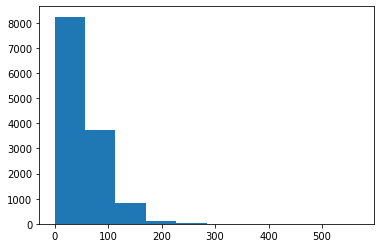

In [805]:
plt.hist(train_x['18_24_res'])

In [1177]:
cols_list

['1',
 'lavka_exist_month',
 'cte_mean',
 'C2_res_by_all_res',
 'dist_lavka_by_samokat',
 'm_res_by_all_res',
 'B1_res_by_all_res',
 'B1_work',
 'C2_res',
 'dist2samokat',
 '35_44_work_by_all_work',
 'cte_std',
 '%_4554',
 '25_34_work_by_all_work',
 '45_54_work_by_all_work',
 '25_34_res_by_all_res',
 'B2_res_by_all_res',
 'A_res',
 '55_99_work_by_all_work',
 '18_24_work_by_all_work',
 '%_3544',
 '0_17_res',
 'Кофейня_hex',
 'Бар безалкогольных напитков_6mbike']

In [1188]:
cols_check = ['1',
 'lavka_exist_month',
 'cte_mean',
 'C2_res_by_all_res',
 'dist_lavka_by_samokat',
 'm_res_by_all_res',
 'B1_res_by_all_res',
 'B1_work',
#  'C2_res',
 'dist2samokat',
 '35_44_work_by_all_work',
 'cte_std',
 '%_4554',
 '25_34_work_by_all_work',
 '45_54_work_by_all_work',
 '25_34_res_by_all_res',
 'B2_res_by_all_res',
 '55_99_work_by_all_work',
 '18_24_work_by_all_work',
 '%_3544',
 '0_17_res',
 'Кофейня_hex']
#  'Бар безалкогольных напитков_6mbike']
#  'Быстрое питание_hex']

In [1189]:


# cols_check = [
#  'B1_res_by_all_res',
#  'C2_res_by_all_res',
#  'lavka_exist_month',
#               'B2_work_by_all_work',
# #  'Магазин продуктов_6mbike',
#     'Бар, паб_6mbike',
#  'Быстрое питание_hex',
# 'dist_lavka_by_samokat',
#  'cte_mean',
#  'dist2samokat',
# 'work_by_res'
            
 
#  ]

In [1190]:
# X_train['1']=1

ols=sm.OLS(train_y,train_x[cols_check]).fit()
print(ols.summary())

                            OLS Regression Results                            
Dep. Variable:                 target   R-squared:                       0.400
Model:                            OLS   Adj. R-squared:                  0.399
Method:                 Least Squares   F-statistic:                     426.9
Date:                Wed, 09 Jun 2021   Prob (F-statistic):               0.00
Time:                        13:50:51   Log-Likelihood:                -17750.
No. Observations:               12835   AIC:                         3.554e+04
Df Residuals:                   12814   BIC:                         3.570e+04
Df Model:                          20                                         
Covariance Type:            nonrobust                                         
                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------
1                          1

In [1191]:
ols=sm.OLS(test_y,test_x[cols_check]).fit()
print(ols.summary())

                            OLS Regression Results                            
Dep. Variable:                 target   R-squared:                       0.463
Model:                            OLS   Adj. R-squared:                  0.461
Method:                 Least Squares   F-statistic:                     236.0
Date:                Wed, 09 Jun 2021   Prob (F-statistic):               0.00
Time:                        13:50:52   Log-Likelihood:                -7290.5
No. Observations:                5501   AIC:                         1.462e+04
Df Residuals:                    5480   BIC:                         1.476e+04
Df Model:                          20                                         
Covariance Type:            nonrobust                                         
                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------
1                          1

In [1192]:

ols=sm.OLS(valid_y,valid_x[cols_check]).fit()
print(ols.summary())

                            OLS Regression Results                            
Dep. Variable:                 target   R-squared:                       0.490
Model:                            OLS   Adj. R-squared:                  0.489
Method:                 Least Squares   F-statistic:                     441.9
Date:                Wed, 09 Jun 2021   Prob (F-statistic):               0.00
Time:                        13:50:53   Log-Likelihood:                -12680.
No. Observations:                9227   AIC:                         2.540e+04
Df Residuals:                    9206   BIC:                         2.555e+04
Df Model:                          20                                         
Covariance Type:            nonrobust                                         
                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------
1                          2

### берем логарифмы и тестим 1 модель на всем датасете

In [2555]:

train_x_log = train_x.copy()

test_x_log = test_x.copy()

valid_x_log = valid_x.copy()

for col in cols_check:
    if col not in ['dist_lavka_by_samokat']:
        train_x_log[col] = np.log(train_x_log[col].apply(lambda x: 0.0001 if x==0 else x))
        test_x_log[col] = np.log(test_x_log[col].apply(lambda x: 0.0001 if x==0 else x))
        valid_x_log[col] = np.log(valid_x_log[col].apply(lambda x: 0.0001 if x==0 else x))


In [2515]:
# sample_valid['target'] = np.log((sample_valid['count_orders']/(sample_valid['ttl_pop']+1)).apply(lambda x: 0.0001 if x==0 else x))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [2445]:
train_x.columns.tolist()

['lavka_exist_month',
 'ttl_pop_res',
 'A_res',
 'B1_res',
 'B2_res',
 'C1_res',
 'C2_res',
 '0_17_res',
 '18_24_res',
 '25_34_res',
 '35_44_res',
 '45_54_res',
 '55_99_res',
 'f_res',
 'm_res',
 '%_female_res',
 '%_C12_res',
 '%_2534',
 '%_3544',
 '%_2544',
 '%_4554',
 'ttl_pop_work',
 'A_work',
 'B1_work',
 'B2_work',
 'C1_work',
 'C2_work',
 '0_17_work',
 '18_24_work',
 '25_34_work',
 '35_44_work',
 '45_54_work',
 '55_99_work',
 'dist_lavka_by_samokat',
 'f_work',
 'm_work',
 '%_female_work',
 '%_C12_work',
 'ttl_pop',
 'flg_samokat_15m',
 'flg_lavka_15m',
 'cte_mean',
 'cte_std',
 'dist2samokat',
 'dist2lavki',
 'Бар безалкогольных напитков_6mbike',
 'Бар, паб_6mbike',
 'Бизнес-центр_6mbike',
 'Булочная, пекарня_6mbike',
 'Быстрое питание_6mbike',
 'Диетические и диабетические продукты_6mbike',
 'Кальян-бар_6mbike',
 'Кафе_6mbike',
 'Кондитерская_6mbike',
 'Кофейня_6mbike',
 'Магазин алкогольных напитков_6mbike',
 'Магазин воды_6mbike',
 'Магазин кулинарии_6mbike',
 'Магазин мяса, 

In [2697]:
import seaborn as sns

In [2698]:
sample_valid['C2_res_by_all_res']=(sample_valid['C2_res']/sample_valid['ttl_pop_res']).fillna(0)

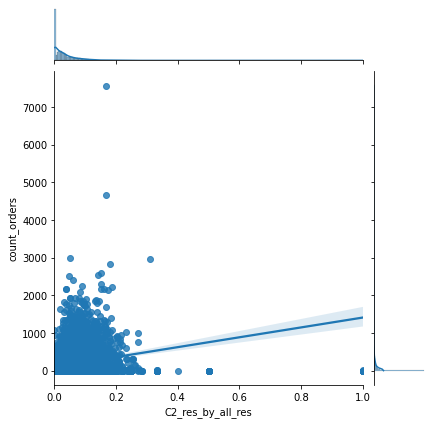

In [2701]:
sns.jointplot(data=sample_valid, x='C2_res_by_all_res', y='count_orders', kind="reg")

In [ ]:
sample_valid

In [2569]:
cols_check=\
[
 'lavka_exist_month',
 'cte_mean',
 'cte_std',
 'C2_res_by_all_res',
#  'dist_lavka_by_samokat',
 'ttl_pop_res',
#     'hex_dist',
#  'm_res_by_all_res',
#  'B1_res_by_all_res',
 'ttl_pop_work',
#  'dist2samokat',
#  '35_44_work_by_all_work',
#  'cte_std',
#  '%_4554',
#  'B2_res_by_all_res',
#  '18_24_work_by_all_work',
#  '%_3544',
#   'Быстрое питание_hex_by_pop',
 'Магазин продуктов_6mbike_by_pop']

In [2696]:
ols_res_train=sm.OLS(train_y,train_x_log[cols_check]).fit()
print(ols_res_train.summary())

                                 OLS Regression Results                                
Dep. Variable:                 target   R-squared (uncentered):                   0.760
Model:                            OLS   Adj. R-squared (uncentered):              0.760
Method:                 Least Squares   F-statistic:                              7831.
Date:                Fri, 18 Jun 2021   Prob (F-statistic):                        0.00
Time:                        19:50:17   Log-Likelihood:                         -40079.
No. Observations:               17275   AIC:                                  8.017e+04
Df Residuals:                   17268   BIC:                                  8.023e+04
Df Model:                           7                                                  
Covariance Type:            nonrobust                                                  
                                      coef    std err          t      P>|t|      [0.025      0.975]
--------------------

In [ ]:
# делаем тесты

In [2704]:
olsr_predictions = ols_res_train.get_prediction(test_x_log[cols_check])
prediction_summary_frame = olsr_predictions.summary_frame()
print(prediction_summary_frame)

           mean   mean_se  mean_ci_lower  mean_ci_upper  obs_ci_lower  \
20463 -1.059547  0.043410      -1.144635      -0.974458     -5.887696   
41524 -3.057313  0.030407      -3.116914      -2.997711     -7.885080   
27673 -2.377942  0.103974      -2.581742      -2.174141     -7.209641   
39677 -6.337853  0.039459      -6.415196      -6.260510    -11.165872   
17393 -6.472725  0.050093      -6.570913      -6.374538    -11.301124   
...         ...       ...            ...            ...           ...   
41775 -7.129931  0.035609      -7.199727      -7.060134    -11.957835   
39357 -1.085869  0.029635      -1.143957      -1.027781     -5.913618   
28132 -7.086486  0.052879      -7.190134      -6.982838    -11.914998   
41442 -1.844675  0.045871      -1.934586      -1.754763     -6.672912   
17062 -2.346215  0.033087      -2.411069      -2.281361     -7.174050   

       obs_ci_upper  
20463      3.768603  
41524      1.770455  
27673      2.453758  
39677     -1.509834  
17393     -1.

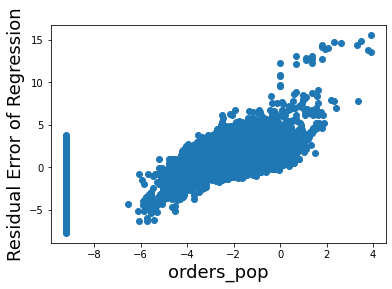

In [2707]:
resid = test_y - prediction_summary_frame ['mean']
plt.xlabel('orders_pop', fontsize=18)
plt.ylabel('Residual Error of Regression', fontsize=18)
plt.scatter(test_y, resid)
plt.show()

In [13]:
plt.hist(resid)

NameError: name 'resid' is not defined

In [2571]:
ols=sm.OLS(test_y,test_x_log[cols_check]).fit()
print(ols.summary())

                                 OLS Regression Results                                
Dep. Variable:                 target   R-squared (uncentered):                   0.753
Model:                            OLS   Adj. R-squared (uncentered):              0.752
Method:                 Least Squares   F-statistic:                              3215.
Date:                Tue, 15 Jun 2021   Prob (F-statistic):                        0.00
Time:                        14:11:37   Log-Likelihood:                         -17325.
No. Observations:                7404   AIC:                                  3.466e+04
Df Residuals:                    7397   BIC:                                  3.471e+04
Df Model:                           7                                                  
Covariance Type:            nonrobust                                                  
                                      coef    std err          t      P>|t|      [0.025      0.975]
--------------------

In [ ]:
ols.

In [2572]:
sample_valid['target']

0        0.086716
2       -9.210340
4        0.320380
6       -9.210340
8        0.219080
           ...   
15469   -2.712208
15470   -1.500097
15471   -1.772753
15472   -9.210340
15473   -9.210340
Name: target, Length: 12340, dtype: float64

In [2596]:
valid_x_log['lavka_exist_month' ]

0        3.258097
2        3.258097
4        3.258097
6        3.258097
8        3.258097
           ...   
15469    2.772589
15470    2.772589
15471    2.772589
15472    2.772589
15473    2.772589
Name: lavka_exist_month, Length: 12340, dtype: float64

In [2573]:
ols=sm.OLS(valid_y,valid_x_log[cols_check]).fit()
print(ols.summary())

                                 OLS Regression Results                                
Dep. Variable:                 target   R-squared (uncentered):                   0.705
Model:                            OLS   Adj. R-squared (uncentered):              0.705
Method:                 Least Squares   F-statistic:                              4215.
Date:                Tue, 15 Jun 2021   Prob (F-statistic):                        0.00
Time:                        14:11:54   Log-Likelihood:                         -29828.
No. Observations:               12340   AIC:                                  5.967e+04
Df Residuals:                   12333   BIC:                                  5.972e+04
Df Model:                           7                                                  
Covariance Type:            nonrobust                                                  
                                      coef    std err          t      P>|t|      [0.025      0.975]
--------------------

(array([3197.,   10.,  245., 1180., 4125., 3247.,  251.,   44.,   32.,
           9.]),
 array([-9.21034037, -7.5908347 , -5.97132903, -4.35182336, -2.7323177 ,
        -1.11281203,  0.50669364,  2.12619931,  3.74570498,  5.36521065,
         6.98471632]),
 <BarContainer object of 10 artists>)

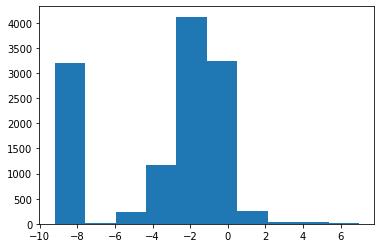

In [2695]:
plt.hist(sample_valid.target)

In [ ]:
plt.hist(sample_valid.)

In [2680]:
sample_valid['predict_penetration'] = np.exp(sample_valid['log_target_predict'])
sample_valid['predict_orders'] =  np.exp(sample_valid['log_target_predict'])*(sample_valid['ttl_pop']+1)

(array([7106., 2271., 1176.,  616.,  387.,  226.,  128.,   75.,   49.,
          34.]),
 array([0.        , 0.19965278, 0.39930556, 0.59895833, 0.79861111,
        0.99826389, 1.19791667, 1.39756944, 1.59722222, 1.796875  ,
        1.99652778]),
 <BarContainer object of 10 artists>)

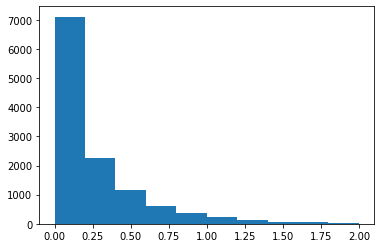

In [2689]:
plt.hist(sample_valid['orders_by_pop'][sample_valid['orders_by_pop']<2]);

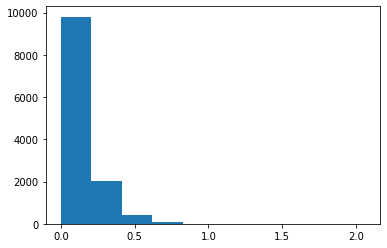

In [2694]:
plt.hist(sample_valid['predict_penetration'], bins=10);

(array([ 1.,  3., 44., 43., 36., 28., 17.,  8.,  5.,  1.]),
 array([-127.66986528,  -65.28348406,   -2.89710283,   59.4892784 ,
         121.87565963,  184.26204085,  246.64842208,  309.03480331,
         371.42118454,  433.80756576,  496.19394699]),
 <BarContainer object of 10 artists>)

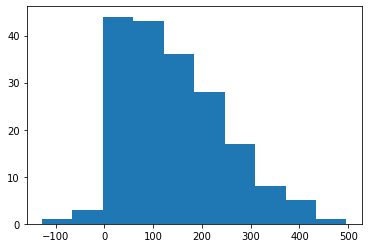

In [2673]:
sample_valid['diff'] = sample_valid.count_orders - sample_valid['predict_orders']

plt.hist(sample_valid.groupby('external_id')['diff'].sum()/30)

{'whiskers': [<matplotlib.lines.Line2D at 0x7f2721771050>,
 'caps': [<matplotlib.lines.Line2D at 0x7f27217718d0>,
 'boxes': [<matplotlib.lines.Line2D at 0x7f272177cc90>],
 'medians': [<matplotlib.lines.Line2D at 0x7f272176a1d0>],
 'fliers': [<matplotlib.lines.Line2D at 0x7f272176a610>],
 'means': []}

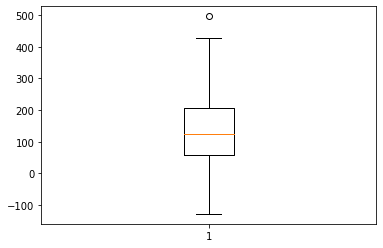

In [2674]:
plt.boxplot( sample_valid.groupby('external_id')['diff'].sum()/30)

In [2678]:
sample_valid['diff'].median()

4.497403580843274

In [2679]:
sample_valid

,month_order,external_id,hex_gid,lavka_exist_month,ttl_pop_res,A_res,B1_res,B2_res,C1_res,C2_res,...,hex_dist,hex_gid_verify,target,orders_by_pop,1,log_target_predict,rank,hex_name,predict_orders,diff
11164,2021-05-01,211658,891181a4583ffff,11,0.18,0.00,0.00,0.00,0.00,0.00,...,5,891181a63abffff,-9.210340,0.000000,1,-7.484991,1.0,211658_1,0.000764,-0.000764
11165,2021-05-01,211658,891181a4593ffff,11,0.56,0.00,0.00,0.00,0.00,0.00,...,4,891181a63abffff,-9.210340,0.000000,1,-7.204008,2.0,211658_2,0.001993,-0.001993
11190,2021-05-01,211658,891181a4597ffff,11,0.83,0.00,0.00,0.00,0.00,0.00,...,4,891181a63abffff,-9.210340,0.000000,1,-7.050994,3.0,211658_3,0.003024,-0.003024
14155,2021-05-01,220790,891181a4907ffff,10,9.35,0.00,2.55,1.70,5.10,0.00,...,7,89118cd16abffff,-9.210340,0.000000,1,-5.632456,1.0,220790_1,0.040093,-0.040093
14130,2021-05-01,220790,891181a490fffff,10,0.27,0.00,0.00,0.00,0.00,0.00,...,7,89118cd16abffff,-9.210340,0.000000,1,-7.565673,2.0,220790_2,0.000798,-0.000798
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10125,2021-05-01,192293,8911aa7b6cfffff,12,650.00,5.00,34.00,224.00,347.00,34.00,...,3,8911aa7b64bffff,-0.948280,0.387407,1,-1.932771,67.0,192293_67,135.627533,227.372467
10127,2021-05-01,192293,8911aa7b6d3ffff,12,299.97,0.99,12.87,90.09,177.21,15.84,...,5,8911aa7b64bffff,-1.317655,0.267762,1,-1.569657,68.0,192293_68,78.501573,22.498427
10079,2021-05-01,192293,8911aa7b6d7ffff,12,569.59,4.74,17.38,180.12,331.80,31.60,...,5,8911aa7b64bffff,-1.021946,0.359894,1,-1.704063,69.0,192293_69,169.357840,165.642160
12404,2021-05-01,185768,8911aa7b6d7ffff,11,136.99,1.14,4.18,43.32,79.80,7.60,...,4,8911aa7b45bffff,-0.937118,0.391755,1,-2.425528,77.0,185768_77,19.864343,68.135657


{'whiskers': [<matplotlib.lines.Line2D at 0x7f271e7b8b50>,
 'caps': [<matplotlib.lines.Line2D at 0x7f271e7b83d0>,
 'boxes': [<matplotlib.lines.Line2D at 0x7f271e7b8ed0>],
 'medians': [<matplotlib.lines.Line2D at 0x7f271e7b1550>],
 'fliers': [<matplotlib.lines.Line2D at 0x7f271e7b1990>],
 'means': []}

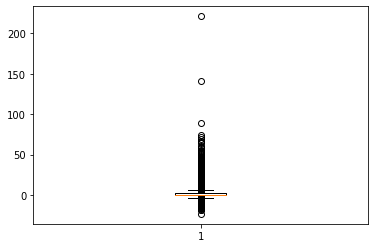

In [2677]:
plt.boxplot( sample_valid['diff']/30)

In [2676]:
sample_valid.columns.tolist()

['month_order',
 'external_id',
 'hex_gid',
 'lavka_exist_month',
 'ttl_pop_res',
 'A_res',
 'B1_res',
 'B2_res',
 'C1_res',
 'C2_res',
 '0_17_res',
 '18_24_res',
 '25_34_res',
 '35_44_res',
 '45_54_res',
 '55_99_res',
 'f_res',
 'm_res',
 '%_female_res',
 '%_C12_res',
 '%_2534',
 '%_3544',
 '%_2544',
 '%_4554',
 'ttl_pop_work',
 'A_work',
 'B1_work',
 'B2_work',
 'C1_work',
 'C2_work',
 '0_17_work',
 '18_24_work',
 '25_34_work',
 '35_44_work',
 '45_54_work',
 '55_99_work',
 'dist_lavka_by_samokat',
 'f_work',
 'm_work',
 '%_female_work',
 '%_C12_work',
 'ttl_pop',
 'count_orders',
 'flg_samokat_15m',
 'flg_lavka_15m',
 'cte_mean',
 'cte_std',
 'dist2samokat',
 'dist2lavki',
 'Бар безалкогольных напитков_6mbike',
 'Бар, паб_6mbike',
 'Бизнес-центр_6mbike',
 'Булочная, пекарня_6mbike',
 'Быстрое питание_6mbike',
 'Гипермаркет_6mbike',
 'Диетические и диабетические продукты_6mbike',
 'Кальян-бар_6mbike',
 'Кафе_6mbike',
 'Кондитерская_6mbike',
 'Кофейня_6mbike',
 'Магазин алкогольных нап

In [2664]:
[ i for i in sample_valid.slug if 'pacaeva' in i]

['yandekslavka_prospekt_pacaeva_7k1',
 'yandekslavka_prospekt_pacaeva_7k1',
 'yandekslavka_prospekt_pacaeva_7k1',
 'yandekslavka_prospekt_pacaeva_7k1',
 'yandekslavka_prospekt_pacaeva_7k1',
 'yandekslavka_prospekt_pacaeva_7k1',
 'yandekslavka_prospekt_pacaeva_7k1',
 'yandekslavka_prospekt_pacaeva_7k1',
 'yandekslavka_prospekt_pacaeva_7k1',
 'yandekslavka_prospekt_pacaeva_7k1',
 'yandekslavka_prospekt_pacaeva_7k1',
 'yandekslavka_prospekt_pacaeva_7k1',
 'yandekslavka_prospekt_pacaeva_7k1',
 'yandekslavka_prospekt_pacaeva_7k1',
 'yandekslavka_prospekt_pacaeva_7k1',
 'yandekslavka_prospekt_pacaeva_7k1',
 'yandekslavka_prospekt_pacaeva_7k1',
 'yandekslavka_prospekt_pacaeva_7k1',
 'yandekslavka_prospekt_pacaeva_7k1',
 'yandekslavka_prospekt_pacaeva_7k1',
 'yandekslavka_prospekt_pacaeva_7k1',
 'yandekslavka_prospekt_pacaeva_7k1',
 'yandekslavka_prospekt_pacaeva_7k1',
 'yandekslavka_prospekt_pacaeva_7k1',
 'yandekslavka_prospekt_pacaeva_7k1',
 'yandekslavka_prospekt_pacaeva_7k1',
 'yandekslav

In [ ]:
sample_valid[cols_check]

In [2667]:
sample_valid[sample_valid.slug=='yandekslavka_prospekt_pacaeva_7k1'].groupby(['external_id','slug']).mean() #['predict_orders']

,,lavka_exist_month,ttl_pop_res,A_res,B1_res,B2_res,C1_res,C2_res,0_17_res,18_24_res,25_34_res,...,region_id,lavka_exist_month_lavka,hex_share_in_zone,hex_dist,target,orders_by_pop,1,log_target_predict,rank,predict_orders
external_id,slug,,,,,,,,,,,,,,,,,,,,,
245674,yandekslavka_prospekt_pacaeva_7k1,9.0,310.867385,1.583692,25.851462,132.521769,139.332154,9.781615,4.912846,42.676846,105.483385,...,213.0,9.0,1.0,4.515385,-4.350844,0.149632,1.0,-4.331212,65.5,29.525136


In [ ]:
plt.scatter(sample_valid['predict_orders'],sample_valid['count_orders'])

In [2658]:
sample_valid['log_target_predict'] = ols.predict(valid_x_log[cols_check])

In [2576]:
sample_valid.columns.to_list()

['month_order',
 'external_id',
 'hex_gid',
 'lavka_exist_month',
 'ttl_pop_res',
 'A_res',
 'B1_res',
 'B2_res',
 'C1_res',
 'C2_res',
 '0_17_res',
 '18_24_res',
 '25_34_res',
 '35_44_res',
 '45_54_res',
 '55_99_res',
 'f_res',
 'm_res',
 '%_female_res',
 '%_C12_res',
 '%_2534',
 '%_3544',
 '%_2544',
 '%_4554',
 'ttl_pop_work',
 'A_work',
 'B1_work',
 'B2_work',
 'C1_work',
 'C2_work',
 '0_17_work',
 '18_24_work',
 '25_34_work',
 '35_44_work',
 '45_54_work',
 '55_99_work',
 'dist_lavka_by_samokat',
 'f_work',
 'm_work',
 '%_female_work',
 '%_C12_work',
 'ttl_pop',
 'count_orders',
 'flg_samokat_15m',
 'flg_lavka_15m',
 'cte_mean',
 'cte_std',
 'dist2samokat',
 'dist2lavki',
 'Бар безалкогольных напитков_6mbike',
 'Бар, паб_6mbike',
 'Бизнес-центр_6mbike',
 'Булочная, пекарня_6mbike',
 'Быстрое питание_6mbike',
 'Гипермаркет_6mbike',
 'Диетические и диабетические продукты_6mbike',
 'Кальян-бар_6mbike',
 'Кафе_6mbike',
 'Кондитерская_6mbike',
 'Кофейня_6mbike',
 'Магазин алкогольных нап

### переименовать гексы

In [ ]:
df.sort_values('value')
tmp = df.groupby('group').size()
rank = tmp.map(range)
rank =[item for sublist in rank for item in sublist]
df['rank'] = rank

In [2634]:
# sample_valid = sample_valid.sort_values(['hex_gid'])
sample_valid['rank' ] = sample_valid.groupby(['external_id'])['1'].rank('first')

In [2637]:
sample_valid['hex_name']=sample_valid['external_id'].astype(str)+'_'+sample_valid['rank' ].astype(int).astype(str)

In [2654]:
sample_valid[sample_valid['rank']>100].groupby(['slug','external_id']).size()+100

slug                                    external_id
yandekslavka_24d                        185793         142
yandekslavka_iniciativnaya_50           106375         108
yandekslavka_kalinina_10                200933         111
yandekslavka_kashirskoe_shosse_48k1     103575         104
yandekslavka_kuzminskaya_19             212333         109
yandekslavka_lva_tolstogo_11k2          214357         129
yandekslavka_mikrorajon_dzerzhinec_21   211653         141
yandekslavka_molodyozhnaya_15           220790         308
yandekslavka_mozhajskoe_shosse_13       216932         239
yandekslavka_novocherkasskij_bulvar_13  169078         115
yandekslavka_oktyabrskaya_33            199828         140
yandekslavka_oktyabrskij_bulvar_14a     212343         167
yandekslavka_proezd_dezhnyova_29k1      153440         127
yandekslavka_prospekt_pacaeva_7k1       245674         130
yandekslavka_pushkinskaya_2a            200103         169
yandekslavka_rossoshanskaya_13a         112360         106
yand

In [2709]:
sample_valid[['address','slug','month_order',
 'external_id',\
 'hex_gid','hex_name','hex_dist','hex_gid_lavka','target','count_orders','log_target_predict','predict_orders',
 'diff',
 'predict_penetration']].join(valid_x[cols_check])\
.to_csv('full_may_data_lrm_1806.csv')

In [2708]:
sample_valid.columns.tolist()

['month_order',
 'external_id',
 'hex_gid',
 'lavka_exist_month',
 'ttl_pop_res',
 'A_res',
 'B1_res',
 'B2_res',
 'C1_res',
 'C2_res',
 '0_17_res',
 '18_24_res',
 '25_34_res',
 '35_44_res',
 '45_54_res',
 '55_99_res',
 'f_res',
 'm_res',
 '%_female_res',
 '%_C12_res',
 '%_2534',
 '%_3544',
 '%_2544',
 '%_4554',
 'ttl_pop_work',
 'A_work',
 'B1_work',
 'B2_work',
 'C1_work',
 'C2_work',
 '0_17_work',
 '18_24_work',
 '25_34_work',
 '35_44_work',
 '45_54_work',
 '55_99_work',
 'dist_lavka_by_samokat',
 'f_work',
 'm_work',
 '%_female_work',
 '%_C12_work',
 'ttl_pop',
 'count_orders',
 'flg_samokat_15m',
 'flg_lavka_15m',
 'cte_mean',
 'cte_std',
 'dist2samokat',
 'dist2lavki',
 'Бар безалкогольных напитков_6mbike',
 'Бар, паб_6mbike',
 'Бизнес-центр_6mbike',
 'Булочная, пекарня_6mbike',
 'Быстрое питание_6mbike',
 'Гипермаркет_6mbike',
 'Диетические и диабетические продукты_6mbike',
 'Кальян-бар_6mbike',
 'Кафе_6mbike',
 'Кондитерская_6mbike',
 'Кофейня_6mbike',
 'Магазин алкогольных нап

In [878]:
train_x[cols_check].corr('spearman')

,B1_res_by_all_res,C2_res_by_all_res,lavka_exist_month,B2_work_by_all_work,Магазин продуктов_6mbike,Быстрое питание_hex,dist_lavka_by_samokat,cte_mean,dist2samokat,work_by_res
B1_res_by_all_res,1.000000,-0.574594,-0.247859,0.379010,-0.358153,-0.070033,-0.173600,0.042252,0.233540,-0.081249
C2_res_by_all_res,-0.574594,1.000000,0.295096,-0.371272,0.446806,0.136838,0.135443,-0.067854,-0.227417,0.114563
lavka_exist_month,-0.247859,0.295096,1.000000,-0.217342,0.291669,0.091790,0.076643,-0.099793,-0.174704,0.184299
B2_work_by_all_work,0.379010,-0.371272,-0.217342,1.000000,-0.197235,-0.081136,-0.046609,-0.029844,0.032473,-0.288415
Магазин продуктов_6mbike,-0.358153,0.446806,0.291669,-0.197235,1.000000,0.299205,0.219414,-0.169608,-0.362492,0.155903
Быстрое питание_hex,-0.070033,0.136838,0.091790,-0.081136,0.299205,1.000000,0.073941,-0.010802,-0.081036,0.199530
dist_lavka_by_samokat,-0.173600,0.135443,0.076643,-0.046609,0.219414,0.073941,1.000000,0.273900,-0.771243,0.000121
cte_mean,0.042252,-0.067854,-0.099793,-0.029844,-0.169608,-0.010802,0.273900,1.000000,0.133198,0.012097
dist2samokat,0.233540,-0.227417,-0.174704,0.032473,-0.362492,-0.081036,-0.771243,0.133198,1.000000,0.010712
work_by_res,-0.081249,0.114563,0.184299,-0.288415,0.155903,0.199530,0.000121,0.012097,0.010712,1.000000


In [272]:
import h3

In [277]:
X_train_new['lat'] = X_train_new['hex_gid'].apply(lambda x: h3.h3_to_geo(x)[0])
X_train_new['long'] = X_train_new['hex_gid'].apply(lambda x: h3.h3_to_geo(x)[1])

In [992]:
train_x['lat'] = sample.loc[train_x.index,'hex_gid'].apply(lambda x: h3.h3_to_geo(x)[0])
train_x['long'] = sample.loc[train_x.index,'hex_gid'].apply(lambda x: h3.h3_to_geo(x)[1])

In [993]:
valid_x['lat'] = sample.loc[valid_x.index,'hex_gid'].apply(lambda x: h3.h3_to_geo(x)[0])
valid_x['long'] = sample.loc[valid_x.index,'hex_gid'].apply(lambda x: h3.h3_to_geo(x)[1])

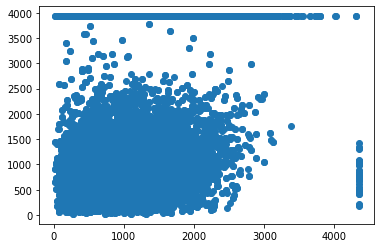

In [268]:
plt.scatter(X_train_new['dist2lavki'], X_train_new['dist2samokat'])

In [267]:
import pykrige

from pykrige.rk import RegressionKriging

from sklearn.linear_model import LinearRegression

In [285]:
np.array(X_train_new.iloc[:,-2:])

array([[55.71792619, 37.57406604],
       [55.71505568, 37.57608783],
       [55.71763234, 37.57920901],
       ...,
       [55.52328213, 37.50910926],
       [55.52585857, 37.51221009],
       [55.52843499, 37.51531139]])

In [997]:
# lr_model = LinearRegression(normalize=True, copy_X=True, fit_intercept=False)
m_rk = RegressionKriging(regression_model=lr_model, n_closest_points=10)
m_rk.fit(train_x[cols_check],np.array(train_x.iloc[:,-2:]),train_y)
print("Regression Score: ", m_rk.regression_model.score(train_x[cols_check],train_y))
print("RK score: ", m_rk.score(train_x[cols_check],np.array(train_x.iloc[:,-2:]),train_y))

Finished learning regression model
Finished kriging residuals
Regression Score:  0.3821029746115233
RK score:  0.5487512285658119


In [998]:
print("Regression Score: ", m_rk.regression_model.score(valid_x[cols_check],valid_y))
print("RK score: ", m_rk.score(valid_x[cols_check],np.array(valid_x.iloc[:,-2:]),valid_y))

Regression Score:  0.37335552970557495
RK score:  0.3177025051301965


In [999]:
print("Regression Score: ", m_rk.regression_model.score(test_x[cols_check],test_y))
print("RK score: ", m_rk.score(test_x[cols_check],np.array(test_x.iloc[:,-2:]),test_y))

Regression Score:  0.3710750256694805
RK score:  0.06998078687210052


In [ ]:
RegressionKriging.fit(X_train_new[cols_list],X_train_new[,-2:],y_trai )

In [2502]:
sample_valid['flg_not0']= log.predict(sample_valid[['ttl_pop_res',  'dist2samokat', 'dist2lavki','ttl_pop_work']])==0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [1194]:
sample_valid['flg_not0'].value_counts()

True     8449
False    3990
Name: flg_not0, dtype: int64

In [2503]:
sample_valid['1'] =1 

for col in cols_div:
        if 'res' in col:
            sample_valid[col+'_by_all_res'] = sample_valid[col]/ (sample_valid['ttl_pop_res']+1)
        elif 'work' in col:
            sample_valid[col+'_by_all_work'] = sample_valid[col]/ (sample_valid['ttl_pop_work']+1)
        else:
            sample_valid[col+'_by_pop'] = sample_valid[col]/ (sample_valid['ttl_pop']+1)
# sample_valid
# ['B1_res_by_all_res', '55_99_work_by_all_work', '25_34_work_by_all_work', '1', '45_54_work_by_all_work', '25_34_res_by_all_res', '35_44_work_by_all_work', 'C2_res_by_all_res', 'B2_res_by_all_res', 'm_res_by_all_res', '18_24_work_by_all_work']

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the docu

In [1198]:
sample_valid.loc[sample_valid['flg_not0']==1,'predict']=np.exp(ols.predict(sample_valid.loc[sample_valid['flg_not0']==1][cols_check]))

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1599: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = infer_fill_value(value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1676: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_column(ilocs[0], value, pi)


In [1223]:
sample_valid1= sample_valid.copy()
sample_valid1['predict']=np.exp(ols.predict(sample_valid1[cols_check]))

In [1200]:
sample_valid.isnull().mean()

month_order               0.0
external_id               0.0
hex_gid                   0.0
lavka_exist_month         0.0
ttl_pop_res               0.0
                         ... 
Супермаркет_hex_by_pop    0.0
Суши-бар_hex_by_pop       0.0
Универмаг_hex_by_pop      0.0
1_by_pop                  0.0
predict                   0.0
Length: 222, dtype: float64

In [1199]:
sample_valid.loc[sample_valid['flg_not0']==0,'predict'] = 0

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1720: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_column(loc, value, pi)


In [1201]:
sample_valid['predict_orders']= sample_valid['predict']*sample_valid['ttl_pop_res']

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [1224]:
sample_valid1['predict_orders']= sample_valid1['predict']*sample_valid1['ttl_pop_res']

In [1713]:
df_by_lavka = sample_valid.groupby(['external_id','month_order'])['predict_orders','count_orders'].sum().reset_index()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  """Entry point for launching an IPython kernel.


In [1225]:
df_by_lavka1 = sample_valid1.groupby(['external_id','month_order'])['predict_orders','count_orders'].sum().reset_index()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  """Entry point for launching an IPython kernel.


In [1218]:
df_by_lavka['ratio'] = abs(df_by_lavka['predict_orders'] - df_by_lavka['count_orders'])/df_by_lavka['count_orders']
df_by_lavka['signed_ratio'] = (df_by_lavka['predict_orders'] - df_by_lavka['count_orders'])/df_by_lavka['count_orders']
df_by_lavka['diff'] = (df_by_lavka['predict_orders'] - df_by_lavka['count_orders'])/31
df_by_lavka['count_orders_per_day'] = (df_by_lavka['predict_orders'])/31

In [1219]:
abs(df_by_lavka['diff']).mean()

945.5905792094718

In [1211]:
abs(df_by_lavka['diff']).sum()

177771.0288913807

In [1226]:
df_by_lavka1['ratio'] = abs(df_by_lavka1['predict_orders'] - df_by_lavka1['count_orders'])/df_by_lavka1['count_orders']
df_by_lavka1['signed_ratio'] = (df_by_lavka1['predict_orders'] - df_by_lavka1['count_orders'])/df_by_lavka1['count_orders']
df_by_lavka1['diff'] = (df_by_lavka1['predict_orders'] - df_by_lavka1['count_orders'])/31
df_by_lavka1['count_orders_per_day'] = (df_by_lavka1['predict_orders'])/31

In [1227]:
abs(df_by_lavka1['diff']).mean()

944.7648384414774

In [1229]:
abs(df_by_lavka1['diff']).sum()

177615.78962699775

In [1228]:
(df_by_lavka1['diff']<0).mean()

0.8457446808510638

In [940]:
sample_valid.groupby('external_id')['predict_orders'].apply(lambda x: np.mean(x==0))

external_id
101892    0.187500
103127    0.343750
103131    0.175000
103143    0.220930
103147    0.336634
            ...   
94832     0.387097
94848     0.352941
94856     0.078947
95104     0.175000
95108     0.303030
Name: predict_orders, Length: 193, dtype: float64

In [1000]:
df_by_lavka_desc = df_by_lavka.merge(sample_valid.groupby('external_id')[cols_check].mean().reset_index(), on ='external_id')

In [1004]:
df_by_lavka_desc.groupby(pd.qcut(df_by_lavka_desc['diff'], q=5)).mean()

,predict_orders,count_orders,ratio,signed_ratio,diff,count_orders_per_day,B1_res_by_all_res,C2_res_by_all_res,lavka_exist_month,B2_work_by_all_work,Магазин продуктов_6mbike,Быстрое питание_hex,dist_lavka_by_samokat,cte_mean,dist2samokat,work_by_res
diff,,,,,,,,,,,,,,,,
"(-673.855, -248.053]",4101.649536,15868.025641,0.751234,-0.751234,-379.560520,132.311275,0.044797,0.075495,15.769231,0.305255,10.766140,0.385780,-0.175083,1177.284423,1266.171963,2.829337
"(-248.053, -140.268]",5834.716678,11671.394737,0.534551,-0.534551,-188.279937,188.216667,0.052792,0.049592,14.473684,0.342223,5.375798,0.194688,-0.007502,1233.348824,1144.760276,2.252669
"(-140.268, -59.635]",5762.409850,8564.256410,0.336752,-0.336752,-90.382147,185.884189,0.058183,0.035617,13.717949,0.362588,3.935484,0.157578,-0.177570,1177.415601,1459.387184,1.550739
"(-59.635, -5.316]",5100.346190,6148.052632,0.191226,-0.191226,-33.796982,164.527296,0.080106,0.022010,11.578947,0.377423,2.354035,0.088269,-0.256461,1297.601634,1898.371740,1.756731
"(-5.316, 249.474]",5909.048955,4950.897436,inf,inf,30.908114,190.614482,0.069192,0.033227,12.769231,0.348370,2.775574,0.146471,-0.329346,1382.468227,1865.591971,1.395374


In [1706]:
df_lavki  = greenplum("select * from analyst.iat_lavki_hex_hist")

In [1708]:
df_lavki_zone = df_lavki[(df_lavki.city=='moscow')&(df_lavki['month_order_left']=='2021-05-01')].groupby(['geometry_zone','external_id_left','month_order_left']).size().reset_index()

In [1710]:
df_lavki.rename(columns = {'external_id_left':'external_id'}, inplace=True)

In [1714]:
df_by_lavka = df_by_lavka.merge(df_lavki_zone, on='external_id')

In [1715]:
df_by_lavka

,external_id,month_order,predict_orders,count_orders,geometry_zone,month_order_left,0
0,101892,2021-05-01,3486.538806,10254.0,"POLYGON ((37.4559 55.8902, 37.4579 55.8894, 37...",2021-05-01,32
1,103127,2021-05-01,4225.232965,8022.0,"POLYGON ((37.4845 55.9007, 37.4845 55.8993, 37...",2021-05-01,32
2,103131,2021-05-01,2920.601707,11959.0,"POLYGON ((37.6603 55.7607, 37.661 55.759, 37.6...",2021-05-01,40
3,103143,2021-05-01,7056.115866,7614.0,"POLYGON ((37.6771 55.8674, 37.6753 55.8679, 37...",2021-05-01,86
4,103147,2021-05-01,10100.508912,11796.0,"POLYGON ((37.391 55.8186, 37.3883 55.8088, 37....",2021-05-01,101
...,...,...,...,...,...,...,...
183,94832,2021-05-01,7722.788647,16750.0,"POLYGON ((37.5728 55.8274, 37.5724 55.8275, 37...",2021-05-01,62
184,94848,2021-05-01,2971.542282,5813.0,"POLYGON ((37.4442 55.899, 37.4432 55.8981, 37....",2021-05-01,34
185,94856,2021-05-01,2361.085709,14103.0,"POLYGON ((37.6317 55.7669, 37.6304 55.7651, 37...",2021-05-01,38
186,95104,2021-05-01,4969.713931,9003.0,"POLYGON ((37.6795 55.7138, 37.6752 55.7125, 37...",2021-05-01,40


In [1716]:
df_by_lavka['geometry_zone']=df_by_lavka['geometry_zone'].apply(lambda x: wkt.loads(x))

In [ ]:
ols_lavka=OLS()


In [1268]:
df_lavka_stores = df_lavki[~pd.isnull(df_lavki['geometry_store'])]

In [1272]:
df_lavka_stores.rename(columns = {'month_order_left':'month_order'}, inplace=True)

/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:4449: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


In [1275]:
sample = sample.merge(df_lavka_stores, on =['external_id','month_order'], suffixes=('','_lavka'))

In [1277]:
sample['hex_dist'] = [h3.h3_(a,b) for a,b in zip(sample['hex_gid'],sample['hex_gid_lavka'])]

In [2587]:
df_hex = sample_valid[['hex_gid','external_id']]

In [2605]:
df_hex_cross = df_hex.merge(df_hex, on='external_id')

In [2606]:
df_hex_cross['hex_dist'] = [h3.h3_distance(a,b) for a,b in zip(df_hex_cross['hex_gid_x'],df_hex_cross['hex_gid_y'])]

In [2607]:
df_hex_cross['min_hex_gid'] = df_hex_cross[['hex_gid_x','hex_gid_y']].min(axis=1)
df_hex_cross['max_hex_gid'] = df_hex_cross[['hex_gid_x','hex_gid_y']].max(axis=1)


In [2608]:
df_hex_cross = df_hex_cross[['external_id','min_hex_gid','max_hex_gid','hex_dist']].drop_duplicates()

In [2614]:
df_hex_cross['min']=df_hex_cross['min_hex_gid'].apply(lambda x:Point(h3.h3_to_geo(x)[1],h3.h3_to_geo(x)[0]))
df_hex_cross['max']=df_hex_cross['max_hex_gid'].apply(lambda x:Point(h3.h3_to_geo(x)[1],h3.h3_to_geo(x)[0]))

In [2618]:
df_hex_cross['min_32637'] = gf.get_gdf(df_hex_cross, 'min', 4326).to_crs('epsg:32637')['min']
df_hex_cross['max_32637'] = gf.get_gdf(df_hex_cross, 'max', 4326).to_crs('epsg:32637')['max']

In [2619]:
df_hex_cross['dist']= df_hex_cross [['min_32637', 'max_32637']].apply(lambda x: gf.dist_2fields(x), axis=1)

In [2620]:
df_hex_cross.to_csv('df_hex_cross_dist.csv')

In [2621]:
df_hex_cross.shape

(545966, 9)

In [2594]:
greenplum.write_table('analyst.iat_hex_cross_dist', df_hex_cross)

In [1233]:
import geo_functions as gf

In [1234]:
df_by_lavka = gf.get_gdf(df_by_lavka,'geometry_zone',4326)

In [1235]:
df_by_lavka

,external_id,month_order,predict_orders,count_orders,ratio,signed_ratio,diff,count_orders_per_day,geometry_zone,month_order_left,0
0,101892,2021-05-01,3486.538806,10254.0,0.659983,-0.659983,-218.305200,112.468994,"POLYGON ((37.45590 55.89020, 37.45790 55.88940...",2021-04-01,32
1,103127,2021-05-01,4225.232965,8022.0,0.473294,-0.473294,-122.476356,136.297838,"POLYGON ((37.48450 55.90070, 37.48450 55.89930...",2021-04-01,32
2,103131,2021-05-01,2920.601707,11959.0,0.755782,-0.755782,-291.561235,94.212958,"POLYGON ((37.66030 55.76070, 37.66100 55.75900...",2021-04-01,40
3,103143,2021-05-01,7056.115866,7614.0,0.073271,-0.073271,-17.996262,227.616641,"POLYGON ((37.67710 55.86740, 37.67530 55.86790...",2021-04-01,86
4,103147,2021-05-01,10100.508912,11796.0,0.143734,-0.143734,-54.693261,325.822868,"POLYGON ((37.39100 55.81860, 37.38830 55.80880...",2021-04-01,101
...,...,...,...,...,...,...,...,...,...,...,...
183,94832,2021-05-01,7722.788647,16750.0,0.538938,-0.538938,-291.200366,249.122214,"POLYGON ((37.57280 55.82740, 37.57240 55.82750...",2021-04-01,62
184,94848,2021-05-01,2971.542282,5813.0,0.488811,-0.488811,-91.659926,95.856203,"POLYGON ((37.44420 55.89900, 37.44320 55.89810...",2021-04-01,34
185,94856,2021-05-01,2361.085709,14103.0,0.832583,-0.832583,-378.771429,76.164055,"POLYGON ((37.63170 55.76690, 37.63040 55.76510...",2021-04-01,38
186,95104,2021-05-01,4969.713931,9003.0,0.447994,-0.447994,-130.106002,160.313353,"POLYGON ((37.67950 55.71380, 37.67520 55.71250...",2021-04-01,40


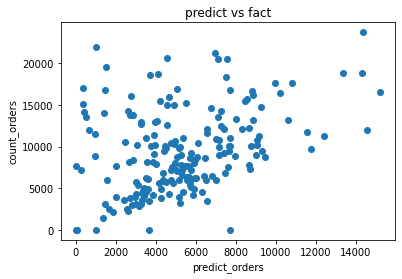

In [977]:
plt.scatter(df_by_lavka['predict_orders'], df_by_lavka['count_orders']);
plt.title('predict vs fact');
plt.xlabel('predict_orders');
plt.ylabel('count_orders');

(array([26., 24., 30., 26., 22., 14., 16., 12.,  6., 12.]),
 array([4.86029942e-04, 1.00437427e-01, 2.00388824e-01, 3.00340221e-01,
        4.00291618e-01, 5.00243015e-01, 6.00194412e-01, 7.00145809e-01,
        8.00097206e-01, 9.00048603e-01, 1.00000000e+00]),
 <BarContainer object of 10 artists>)

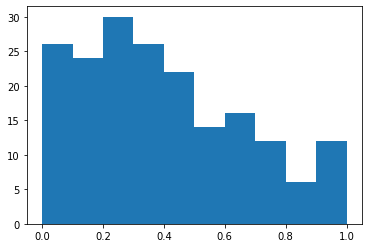

In [945]:
plt.hist(df_by_lavka[df_by_lavka['ratio']<np.inf]['ratio'])

In [ ]:
# смотрим зависимость дистанции от cte

In [2290]:
sample['geometry_store']=sample['geometry_store'].apply(lambda x: wkt.loads(x))

sample['hex_gid_verify'] = sample['geometry_store'].apply(lambda x: h3.geo_to_h3(x.y,x.x, 9))

sample=sample[sample['hex_gid_verify']==sample['hex_gid_lavka']]

In [2310]:
sample_dist_cte = sample.groupby(['external_id','hex_dist'])['cte_mean'].apply(lambda x: np.mean(x)).reset_index()

In [2311]:
sample_dist_cte.groupby(['hex_dist'])['cte_mean'].mean()/60

hex_dist
0     12.508264
1     15.718035
2     18.310500
3     20.570979
4     23.037646
5     24.590055
6     26.025617
7     27.525235
8     27.336531
9     27.551400
10    28.808321
11    28.717391
12    28.337280
13    28.644641
14    28.440107
15    27.648762
Name: cte_mean, dtype: float64

In [2312]:
sample_dist_cte['dist_rank'] = sample_dist_cte.groupby('external_id')['hex_dist'].rank()
sample_dist_cte['cte_rank'] = sample_dist_cte.groupby('external_id')['cte_mean'].rank('first')

In [2313]:
sample_dist_cte = sample_dist_cte.merge(sample_dist_cte[['cte_rank','cte_mean','external_id']],
                     left_on =['dist_rank','external_id'] ,
                     right_on =['cte_rank','external_id'] )

In [2314]:
sample_dist_cte['cte_fin'] = sample_dist_cte[['cte_mean_x','cte_mean_y']].mean(axis=1)

In [2315]:
sample_dist_cte['cte_fin_rank'] = sample_dist_cte.groupby('external_id')['cte_fin'].rank('first')

In [2316]:
sample_dist_cte['coef'] = round(sample_dist_cte['cte_fin']/sample_dist_cte.groupby('external_id')['cte_fin'].transform('min'),2)

In [2317]:
sample_dist_cte_mean = sample_dist_cte.groupby('hex_dist', as_index=False)['coef'].mean()

In [2610]:
sample_dist_cte_mean

,hex_dist,coef
0,0,1.000095
1,1,1.281469
2,2,1.496919
3,3,1.681848
4,4,1.884115
5,5,2.002677
6,6,2.093926
7,7,2.192342
8,8,2.255775
9,9,2.338780


In [2611]:
8/7

1.1428571428571428

In [2319]:
sample_dist_cte_mean.loc[sample_dist_cte_mean.hex_dist>=12,'coef']=3

In [1314]:
sample_dist_cte[['cte_fin_rank','dist_rank']].corr('spearman')

,cte_fin_rank,dist_rank
cte_fin_rank,1.000000,0.989246
dist_rank,0.989246,1.000000


#### Добавляем список с лучшими гексами, пересчитываем на них дистанцию, возвращаем новый cte

In [2266]:
df_lavki[df_lavki['month_order_left']=='2021-05-01'].groupby(['hex_gid','external_id']).size()[
    df_lavki[df_lavki['month_order_left']=='2021-05-01'].groupby(['hex_gid','external_id']).size()>1
]

hex_gid          external_id
8911aa62ca7ffff  207723         2
                 394198         2
dtype: int64

In [2267]:
df_best_hex

,external_id,hex_gid,hex_centre,hex_centre_32637
23,60287,8911aa7a367ffff,POINT (55.72654 37.56800),POINT (1982358.516 4291979.738)
141,135345,8911aa7aa07ffff,POINT (55.74597 37.61357),POINT (1983154.889 4297406.297)
212,214357,8911aa68ed3ffff,POINT (55.70185 37.89635),POINT (1973397.378 4328373.723)
249,185788,8911aa68e6bffff,POINT (55.70000 37.92727),POINT (1972594.278 4331807.246)
299,173213,8911aa78cc3ffff,POINT (55.73647 37.63508),POINT (1981865.173 4299661.052)
...,...,...,...,...
13653,94816,8911aa703c3ffff,POINT (55.83895 37.52814),POINT (1993214.052 4289356.109)
13701,189828,8911aa4d133ffff,POINT (55.54397 37.48476),POINT (1967759.061 4279682.281)
13714,404249,891181b6c2fffff,POINT (55.62937 37.67569),POINT (1971488.473 4302465.312)
13717,408519,891181b6b87ffff,POINT (55.62666 37.72192),POINT (1970300.968 4307601.330)


In [2220]:
def get_cte_hex(df_best_hex, df_lavki_m, df_dist_cte): # hex, external_id
    df_best_hex['hex_centre'] = df_best_hex['hex_gid'].apply(lambda x: Point( h3.h3_to_geo(x)))

    df_best_hex['hex_centre_32637'] = gf.get_gdf(df_best_hex, 'hex_centre', 4326).to_crs('epsg:32637')['hex_centre']

    df_best_hex['external_id'] = df_best_hex['external_id'].astype(str)

    df_best_hex_all = df_best_hex.merge(df_lavki_m, on='external_id', how='inner')

    df_best_hex_all['hex_dist'] = [h3.h3_distance(a,b) for a,b in zip(df_best_hex_all['hex_gid_x'],df_best_hex_all['hex_gid_y'])]  #  дистанция между этим гексом и другими гексами

#     df_best_hex_all = df_best_hex_all.merge(df_dist_cte, 
#                          on=['hex_dist','external_id'], how='left'
#                          )
    df_best_hex_all = df_best_hex_all.merge( df_dist_cte, 
                         on=['hex_dist'], how='left'
                          )

    
#     print(df_best_hex_all.isnull().mean())

#     df_best_hex_all['cte_sec']=df_best_hex_all['cte_mean']*60
    
#     df_best_hex_all.rename(columns={'hex_gid_x':'hex_gid_best','hex_gid_y':'hex_gid'}, inplace=True)
# #     print(df_best_hex_all.head())
# #     print(df_best_hex_all ['external_id'].nunique())
    
#     df_hex_cte_month = df_best_hex_all[['hex_gid','external_id','cte_sec','hex_dist']]\
#                         .merge(sample[sample['month_order']=='2021-05-01']\
#                                [['external_id','hex_gid','count_orders','cte_mean']].drop_duplicates(),
#                                 on =['external_id','hex_gid']
                                                             
#                           ).reset_index()

#     df_hex_cte_month = df_hex_cte_month.drop_duplicates()
    
    
    return df_best_hex_all
    

In [ ]:

#     df_cte_new_old = \
# df_best_hex_all.groupby(['external_id','hex_gid_best'])['cte_sec'].mean().reset_index().merge(sample[sample['month_order']=='2021-05-01'].groupby(['external_id','hex_gid_lavka'])['cte_mean'].mean().reset_index(), how='inner', on =['external_id'] )
#     df_cte_new_old.columns = ['external_id', 'best_hex_gid_new',  'cte_mean_new','hex_gid_lavka', 'cte_mean_old']

#     df_cte_new_old['rank']=df_cte_new_old.groupby('external_id')['cte_mean_old'].rank(ascending=False, method='first')

#     df_cte_new_old = df_cte_new_old[df_cte_new_old['rank']==1]

#     df_cte_new_old['flg_same_hex'] = df_cte_new_old['best_hex_gid_new'] == df_cte_new_old['hex_gid_lavka']

#     df_cte_new_old['cte_sec_same_considered']=[ i if not(k) else j for i,j,k in zip(df_cte_new_old['cte_mean_new'],df_cte_new_old['cte_mean_old'],df_cte_new_old['flg_same_hex'])]
    
#     return df_hex_cte_month.merge(df_cte_new_old[['external_id','flg_same_hex']], on='external_id'),df_cte_new_old

In [2143]:
df_best_hex = pd.read_csv('best_hex_model_1306.csv', sep=',', index_col=0)

In [2141]:
gdf_hex = greenplum("select * from analyst.iat_hex_tbl where city='moscow'")

In [2145]:
gdf_hex['geometry'] = gdf_hex['geometry'].apply(lambda x: wkt.loads(x))

gdf_best_hex = gf.get_gdf(df_best_hex.merge(gdf_hex, on='hex_gid' ),
                          'geometry',
                          4326)

In [2322]:
df_orders_hex = sample_valid[['count_orders','hex_gid','external_id']].copy()

gdf_orders_hex = gf.get_gdf(df_orders_hex.merge(gdf_hex, on='hex_gid' ),
                          'geometry',
                          4326)

In [1834]:
df_lavki.rename(columns = {'external_id_left':'external_id'}, inplace=True)

In [2382]:
# import gc
gc.collect()

54

In [2324]:
df_hex_cte_model_best  = \
        get_cte_hex(df_best_hex,
            df_lavki[df_lavki['month_order_left']=='2021-05-01'],
            sample_dist_cte_mean
           )

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  


In [2326]:
df_hex_cte_model_best.drop_duplicates(inplace=True)

In [2327]:
df_hex_cte_model_best.groupby(['external_id','hex_gid_y']).size()[df_hex_cte_model_best.groupby(['external_id','hex_gid_y']).size()>1]

Series([], dtype: int64)

In [2329]:
df_hex_cte_model_best.rename(columns={'hex_gid_x':'hex_gid_best','hex_gid_y':'hex_gid'}, inplace=True)

In [2341]:
df_hex_cte_model_best1 = df_hex_cte_model_best.merge ( sample[sample['month_order']=='2021-05-01']\
                               [['external_id','hex_gid','count_orders','cte_mean','hex_dist']],
                                   on=['hex_gid','external_id'],
                             suffixes=('_model','_fact')
                                  ).merge (sample_dist_cte_mean,
                                          left_on='hex_dist_fact',
                                          right_on='hex_dist',
                                          suffixes=('','_fact'))

In [2348]:
df_hex_cte_model_best1.drop_duplicates(inplace=True)

df_hex_cte_model_best1.drop('hex_dist',axis=1 , inplace=True)

df_hex_cte_model_best1.groupby(['external_id','hex_gid']).size()[df_hex_cte_model_best1.groupby(['external_id','hex_gid']).size()>1]

In [2351]:
(df_hex_cte_model_best1 ['hex_dist_fact']!=df_hex_cte_model_best1 ['hex_dist_model']).mean()

0.49353159851301115

In [2354]:
df_hex_cte_model_best1.columns

Index(['external_id', 'hex_gid_best', 'hex_centre', 'hex_centre_32637',
       'month_order_left', 'address', 'assortment_id', 'cluster', 'dt',
       'ezones', 'group_id', 'lsn', 'price_list_id', 'print_id', 'region_id',
       'samples', 'slug', 'source', 'status', 'store_id', 'title', 'user_id',
       'geometry_zone', 'city', 'hex_gid', 'lavka_first_month',
       'lavka_exist_month', 'main_delivery_type', 'geometry_store',
       'hex_share_in_zone', 'hex_dist_model', 'coef', 'count_orders',
       'cte_mean', 'hex_dist_fact', 'coef_fact'],
      dtype='object')

In [2400]:
df_hex_cte_model_best1['coef'].fillna(3.0,inplace=True)

In [2401]:
df_hex_cte_model_best1['new_cte'] = df_hex_cte_model_best1['cte_mean']/df_hex_cte_model_best1['coef_fact']*df_hex_cte_model_best1['coef']

In [2402]:
df_hex_cte_model_best1[['new_cte','cte_mean']].mean()

new_cte     1321.197455
cte_mean    1292.517064
dtype: float64

In [2358]:
df_hex_cte_model_best1[df_hex_cte_model_best1['new_cte'] <df_hex_cte_model_best1['cte_mean']]

,external_id,hex_gid_best,hex_centre,hex_centre_32637,month_order_left,address,assortment_id,cluster,dt,ezones,...,main_delivery_type,geometry_store,hex_share_in_zone,hex_dist_model,coef,count_orders,cte_mean,hex_dist_fact,coef_fact,new_cte
1,60287,8911aa7a367ffff,POINT (55.72654 37.56800),POINT (1982358.516 4291979.738),2021-05-01,"119048, Москва г, Кооперативная ул, дом № 2, к...",99c3f97c5e8c46d2b6b5af83396fa6f5000200010001,Москва,2021-05-01,"{""ext1"": {""zone"": {""type"": ""Feature"", ""geometr...",...,foot,None,1.00,3,1.681848,896.0,976.489143,3,1.681848,976.489143
47,185788,8911aa68e6bffff,POINT (55.70000 37.92727),POINT (1972594.278 4331807.246),2021-05-01,"111674 , Москва г, Защитников Москвы проспект,...",99c3f97c5e8c46d2b6b5af83396fa6f5000200010001,Москва,2021-05-01,"{""main"": {""zone"": {""type"": ""Feature"", ""geometr...",...,foot,None,1.00,2,1.496919,13.0,1464.692308,3,1.681848,1303.640954
48,185788,8911aa68e6bffff,POINT (55.70000 37.92727),POINT (1972594.278 4331807.246),2021-05-01,"111674 , Москва г, Защитников Москвы проспект,...",99c3f97c5e8c46d2b6b5af83396fa6f5000200010001,Москва,2021-05-01,"{""main"": {""zone"": {""type"": ""Feature"", ""geometr...",...,foot,None,1.00,1,1.281469,27.0,1282.592593,3,1.681848,977.259873
49,185788,8911aa68e6bffff,POINT (55.70000 37.92727),POINT (1972594.278 4331807.246),2021-05-01,"111674 , Москва г, Защитников Москвы проспект,...",99c3f97c5e8c46d2b6b5af83396fa6f5000200010001,Москва,2021-05-01,"{""main"": {""zone"": {""type"": ""Feature"", ""geometr...",...,foot,None,1.00,0,1.000095,765.0,1072.863874,3,1.681848,637.968086
50,185788,8911aa68e6bffff,POINT (55.70000 37.92727),POINT (1972594.278 4331807.246),2021-05-01,"111674 , Москва г, Защитников Москвы проспект,...",99c3f97c5e8c46d2b6b5af83396fa6f5000200010001,Москва,2021-05-01,"{""main"": {""zone"": {""type"": ""Feature"", ""geometr...",...,foot,None,1.00,1,1.281469,252.0,1037.670683,3,1.681848,790.643830
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13512,198913,8911aa70d23ffff,POINT (55.90485 37.58061),POINT (1998008.135 4296325.885),2021-05-01,"127410, Москва г, Алтуфьевское шоссе ул, дом №...",99c3f97c5e8c46d2b6b5af83396fa6f5000200010001,Москва,2021-05-01,"{""main"": {""zone"": {""type"": ""Feature"", ""geometr...",...,foot,None,0.20,6,2.093926,0.0,1465.078602,11,2.783333,1102.191641
13523,220790,89118cd16abffff,POINT (55.60432 38.09213),POINT (1960712.130 4348712.925),2021-05-01,"140186, Жуковский г, Молодежная ул, дом № 15",99c3f97c5e8c46d2b6b5af83396fa6f5000200010001,Москва,2021-05-01,"{""ext1"": {""zone"": {""type"": ""Feature"", ""geometr...",...,foot,None,0.00,11,2.783333,10.0,1496.100000,11,2.783333,1496.100000
13540,198913,8911aa70d23ffff,POINT (55.90485 37.58061),POINT (1998008.135 4296325.885),2021-05-01,"127410, Москва г, Алтуфьевское шоссе ул, дом №...",99c3f97c5e8c46d2b6b5af83396fa6f5000200010001,Москва,2021-05-01,"{""main"": {""zone"": {""type"": ""Feature"", ""geometr...",...,foot,None,0.04,8,2.255775,0.0,1465.078602,12,3.000000,1101.629056
13541,198913,8911aa70d23ffff,POINT (55.90485 37.58061),POINT (1998008.135 4296325.885),2021-05-01,"127410, Москва г, Алтуфьевское шоссе ул, дом №...",99c3f97c5e8c46d2b6b5af83396fa6f5000200010001,Москва,2021-05-01,"{""main"": {""zone"": {""type"": ""Feature"", ""geometr...",...,foot,None,0.24,7,2.192342,4.0,2340.250000,12,3.000000,1710.209722


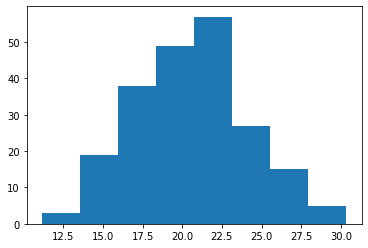

In [2179]:
# фактический cte мая
plt.hist(df_hex_cte_model_best.groupby(['external_id'])['cte_mean'].mean()/60, bins=8);


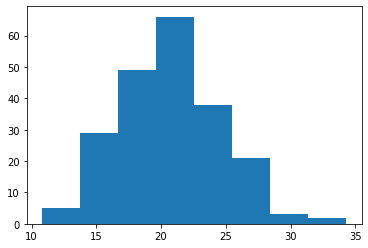

In [2247]:
plt.hist(df_hex_cte_model_best.groupby(['external_id'])['new_cte'].mean()/60, bins=8);

(array([ 2.,  9., 18., 32., 38., 38., 44., 14., 11.,  7.]),
 array([13.26527778, 15.34106667, 17.41685556, 19.49264444, 21.56843333,
        23.64422222, 25.72001111, 27.7958    , 29.87158889, 31.94737778,
        34.02316667]),
 <BarContainer object of 10 artists>)

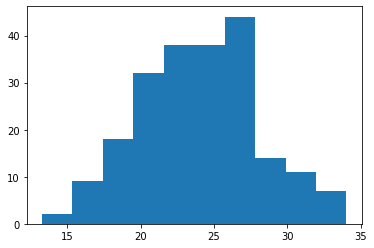

In [2186]:
plt.hist(df_hex_cte_model_best.groupby(['external_id'])['cte_mean'].quantile(0.85)/60)

In [ ]:
df_hex_cte_model_best[['external_id','hex_gid','new_cte']],
                          on=['external_id','hex_gid']).to_csv('df_hex_cte_model_new_cte.csv')

In [2187]:
df_hex_cte_model_best.groupby(['external_id'])['cte_mean'].quantile(0.85).mean()

1440.5891012435268

In [2188]:
df_hex_cte_model_best['cte_sec']=\
df_hex_cte_model_best['cte_sec'].fillna(1441)

In [1848]:
df_best_hex_coverage = gpd.read_file('гексы_лавки_изохроны_охват.geojson')

In [2124]:
df_best_hex_coverage['geometry']

0        POLYGON ((37.72786 55.59230, 37.73024 55.59124...
1        POLYGON ((37.73612 55.59457, 37.73850 55.59351...
2        POLYGON ((37.73925 55.59714, 37.74163 55.59608...
3        POLYGON ((37.74751 55.59941, 37.74989 55.59835...
4        POLYGON ((37.76203 55.60683, 37.76441 55.60577...
                               ...                        
11186    POLYGON ((37.51319 55.76453, 37.51558 55.76348...
11187    POLYGON ((37.51631 55.76711, 37.51870 55.76606...
11188    POLYGON ((37.51117 55.76740, 37.51356 55.76635...
11189    POLYGON ((37.50290 55.76511, 37.50529 55.76406...
11190    POLYGON ((37.50602 55.76769, 37.50841 55.76664...
Name: geometry, Length: 11191, dtype: geometry

In [2360]:
df_hex_cte_cov_best= \
        get_cte_hex(df_best_hex_coverage [df_best_hex_coverage ['rank_within_zone']==1][['external_id','hex_gid']],
            df_lavki[df_lavki['month_order_left']=='2021-05-01'],
            sample_dist_cte_mean
           )

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  


In [2361]:
df_hex_cte_cov_best.drop_duplicates(inplace=True)

In [2395]:
df_hex_cte_cov_best['coef'].fillna(3.0,inplace=True)

In [2363]:
df_hex_cte_cov_best.rename(columns={'hex_gid_x':'hex_gid_best','hex_gid_y':'hex_gid'}, inplace=True)

In [2365]:
df_hex_cte_cov_best.head()

,external_id,hex_gid_best,hex_centre,hex_centre_32637,month_order_left,address,assortment_id,cluster,dt,ezones,...,geometry_zone,city,hex_gid,lavka_first_month,lavka_exist_month,main_delivery_type,geometry_store,hex_share_in_zone,hex_dist,coef
0,375098,891181b4c57ffff,POINT (55.59502 37.74401),POINT (1967032.853 4309562.512),2021-05-01,"142714, Московская область, п. Развилка, д. 16",99c3f97c5e8c46d2b6b5af83396fa6f5000200010001,Москва,2021-05-01,"{""ext1"": {""zone"": {""type"": ""Feature"", ""geometr...",...,"POLYGON ((37.7337 55.5889, 37.7302 55.5916, 37...",moscow,891181b4cdbffff,2021-04-01,2,foot,None,0.13,3,1.681848
1,375098,891181b4c57ffff,POINT (55.59502 37.74401),POINT (1967032.853 4309562.512),2021-05-01,"142714, Московская область, п. Развилка, д. 16",99c3f97c5e8c46d2b6b5af83396fa6f5000200010001,Москва,2021-05-01,"{""ext1"": {""zone"": {""type"": ""Feature"", ""geometr...",...,"POLYGON ((37.7337 55.5889, 37.7302 55.5916, 37...",moscow,891181b4ccfffff,2021-04-01,2,foot,None,0.50,1,1.281469
2,375098,891181b4c57ffff,POINT (55.59502 37.74401),POINT (1967032.853 4309562.512),2021-05-01,"142714, Московская область, п. Развилка, д. 16",99c3f97c5e8c46d2b6b5af83396fa6f5000200010001,Москва,2021-05-01,"{""ext1"": {""zone"": {""type"": ""Feature"", ""geometr...",...,"POLYGON ((37.7337 55.5889, 37.7302 55.5916, 37...",moscow,891181b4c1bffff,2021-04-01,2,foot,None,0.13,1,1.281469
3,375098,891181b4c57ffff,POINT (55.59502 37.74401),POINT (1967032.853 4309562.512),2021-05-01,"142714, Московская область, п. Развилка, д. 16",99c3f97c5e8c46d2b6b5af83396fa6f5000200010001,Москва,2021-05-01,"{""ext1"": {""zone"": {""type"": ""Feature"", ""geometr...",...,"POLYGON ((37.7337 55.5889, 37.7302 55.5916, 37...",moscow,891181b4c0fffff,2021-04-01,2,foot,None,0.04,2,1.496919
4,375098,891181b4c57ffff,POINT (55.59502 37.74401),POINT (1967032.853 4309562.512),2021-05-01,"142714, Московская область, п. Развилка, д. 16",99c3f97c5e8c46d2b6b5af83396fa6f5000200010001,Москва,2021-05-01,"{""ext1"": {""zone"": {""type"": ""Feature"", ""geometr...",...,"POLYGON ((37.7337 55.5889, 37.7302 55.5916, 37...",moscow,891181b4d5bffff,2021-04-01,2,foot,None,0.05,6,2.093926


In [2403]:
df_hex_cte_best_2ways =\
df_hex_cte_model_best1.merge ( df_hex_cte_cov_best[['external_id','hex_dist','hex_gid']],
                                  
                                   on = ['hex_gid', 'external_id'],
                             suffixes=('_cov',''))\
.merge(sample_dist_cte_mean,
                                          on='hex_dist',

                                          suffixes=('','_cov'))
                                 

In [2404]:
df_hex_cte_best_2ways.isnull().mean()

external_id           0.000000
hex_gid_best          0.000000
hex_centre            0.000000
hex_centre_32637      0.000000
month_order_left      0.000000
address               0.000000
assortment_id         0.000000
cluster               0.000000
dt                    0.000000
ezones                0.000000
group_id              0.000000
lsn                   0.000000
price_list_id         0.000000
print_id              0.000000
region_id             0.000000
samples               0.000000
slug                  0.000000
source                0.000000
status                0.000000
store_id              0.000000
title                 0.000000
user_id               0.614833
geometry_zone         0.000000
city                  0.000000
hex_gid               0.000000
lavka_first_month     0.000000
lavka_exist_month     0.000000
main_delivery_type    0.000000
geometry_store        0.982616
hex_share_in_zone     0.000000
hex_dist_model        0.000000
coef                  0.000000
count_or

In [2384]:
df_hex_cte_best_2ways.columns

Index(['external_id', 'hex_gid_best', 'hex_centre', 'hex_centre_32637',
       'month_order_left', 'address', 'assortment_id', 'cluster', 'dt',
       'ezones', 'group_id', 'lsn', 'price_list_id', 'print_id', 'region_id',
       'samples', 'slug', 'source', 'status', 'store_id', 'title', 'user_id',
       'geometry_zone', 'city', 'hex_gid', 'lavka_first_month',
       'lavka_exist_month', 'main_delivery_type', 'geometry_store',
       'hex_share_in_zone', 'hex_dist_model', 'coef', 'count_orders',
       'cte_mean', 'hex_dist_fact', 'coef_fact', 'new_cte', 'hex_dist',
       'coef_cov'],
      dtype='object')

In [2405]:
df_hex_cte_best_2ways['new_cte_cov'] = df_hex_cte_best_2ways['cte_mean']/df_hex_cte_best_2ways['coef_fact']*df_hex_cte_best_2ways['coef_cov']

In [2406]:
df_hex_cte_best_2ways[['external_id', 'hex_gid_best', 'hex_gid','count_orders', 'cte_mean', 'coef_fact','hex_dist_fact',
        'new_cte', 'hex_dist_model', 'coef', 'new_cte_cov','hex_dist',
       'coef_cov']].to_csv('df_hex_cte_best_withcoef.csv')

In [2394]:
df_hex_cte_best_2ways.isnull().mean()

external_id           0.000000
hex_gid_best          0.000000
hex_centre            0.000000
hex_centre_32637      0.000000
month_order_left      0.000000
address               0.000000
assortment_id         0.000000
cluster               0.000000
dt                    0.000000
ezones                0.000000
group_id              0.000000
lsn                   0.000000
price_list_id         0.000000
print_id              0.000000
region_id             0.000000
samples               0.000000
slug                  0.000000
source                0.000000
status                0.000000
store_id              0.000000
title                 0.000000
user_id               0.614833
geometry_zone         0.000000
city                  0.000000
hex_gid               0.000000
lavka_first_month     0.000000
lavka_exist_month     0.000000
main_delivery_type    0.000000
geometry_store        0.982616
hex_share_in_zone     0.000000
hex_dist_model        0.000000
coef                  0.000399
count_or

In [2190]:
df_hex_cte_cov_best['cte_sec']=\
df_hex_cte_cov_best['cte_sec'].fillna(1441)#df_hex_cte_cov_best.groupby('external_id')['cte_sec'].transform('max'))

In [2067]:
# df_hex_cte_cov_best['cte_sec_weighted'] = df_hex_cte_cov_best['cte_sec']*df_hex_cte_cov_best['count_orders']

In [2066]:
#df_hex_cte_cov_best.groupby(['external_id'])['cte_sec'].agg(['mean','max'])

In [2191]:
(df_hex_cte_cov_best['cte_sec']-df_hex_cte_cov_best['cte_mean']).sum()

775454.3822364106

In [ ]:
# df_hex_cte_cov_best.groupby('external_id')[['cte_sec_weighted','cte_mean']]

In [2195]:
df_hex_cte_cov_best.merge(df_hex_cte_model_best[['external_id','hex_gid','cte_sec']],
                          on=['external_id','hex_gid']).to_csv('df_hex_cte_cov_model_best.csv')

In [2201]:
df_hex_cte_model_best[df_hex_cte_model_best['external_id']=='103131']

,index,hex_gid,external_id,cte_sec,hex_dist,count_orders,cte_mean
7578,7578,8911aa78c97ffff,103131,1290.0,5,0.0,1544.827142
7579,7579,8911aa78c87ffff,103131,1290.0,4,74.0,1139.301370
7580,7580,8911aa7ab5bffff,103131,1290.0,5,0.0,1544.827142
7581,7581,8911aa78c17ffff,103131,1290.0,5,27.0,1229.481481
7582,7582,8911aa78c8fffff,103131,1290.0,5,0.0,1544.827142
7583,7583,8911aa7ab43ffff,103131,1290.0,4,104.0,1047.403846
7584,7584,8911aa7ab7bffff,103131,1020.0,2,226.0,809.898230
7585,7585,8911aa7ab47ffff,103131,1200.0,3,29.0,1151.965517
7586,7586,8911aa7ab63ffff,103131,840.0,1,537.0,795.861940
7587,7587,8911aa78d9bffff,103131,840.0,1,839.0,859.223417


In [2057]:
#df_hex_cte_cov_best[['cte_sec_weighted', 'cte_mean']]

In [2095]:
df_hex_cte_cov_best['cte_sec_weighted']= df_hex_cte_cov_best['cte_sec']*df_hex_cte_cov_best['count_orders']/df_hex_cte_cov_best.groupby('external_id').count_orders.transform('sum')

df_hex_cte_cov_best.groupby('external_id')['cte_sec_weighted', 'cte_mean'].agg({'cte_sec_weighted':'sum',
                                                                            'cte_mean':'mean'})

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  This is separate from the ipykernel package so we can avoid doing imports until


,cte_sec_weighted,cte_mean
external_id,,
101892,852.030427,803.411690
103127,1209.850411,1213.232554
103131,1123.350615,1098.954041
103143,1474.976359,1352.198326
103147,1443.138352,1549.369520
...,...,...
94832,1057.225075,1028.471918
94848,1108.250473,956.693121
94856,1216.532653,1189.693865


In [2096]:
df_hex_cte_cov_best[['external_id','hex_gid','cte_sec']].merge(df_hex_cte_model_best[['external_id','hex_gid','cte_sec']],
                                                               on=['hex_gid','external_id'],
                                                              suffixes=('_coverage','_model')).to_csv('new_cte_cov_model.csv')

In [2097]:
df_hex_cte_model_best['cte_sec_weighted']= df_hex_cte_model_best['cte_sec']*df_hex_cte_model_best['count_orders']/df_hex_cte_model_best.groupby('external_id').count_orders.transform('sum')



In [2098]:
df_model_compare = df_hex_cte_model_best.groupby('external_id')['cte_sec_weighted', 'cte_mean'].agg({'cte_sec_weighted':'sum',
                                                                            'cte_mean':'mean'})

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  """Entry point for launching an IPython kernel.


In [2099]:
df_model_compare.join(df_hex_cte_cov_best.groupby('external_id')['cte_sec_weighted', 'cte_mean'].agg({'cte_sec_weighted':'sum'})
                      ,lsuffix='_model_best', rsuffix='_coverage_best').to_csv('df_model_compare.csv')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  """Entry point for launching an IPython kernel.


In [2100]:
df_model_compare = df_model_compare.join(df_hex_cte_cov_best.groupby('external_id')['cte_sec_weighted', 'cte_mean'].agg({'cte_sec_weighted':'sum'})
                      ,lsuffix='_model_best', rsuffix='_coverage_best')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  """Entry point for launching an IPython kernel.


In [2104]:
df_model_compare.mean()

cte_sec_weighted_model_best       1072.051926
cte_mean                          1154.350114
cte_sec_weighted_coverage_best    1191.809468
dtype: float64

In [2106]:
df_hex_cte_model_best.groupby('external_id').size()

external_id
103547     59
103551     51
105923     41
109873     70
112335     55
116360     74
149840     39
149860     49
178463     50
185748     48
185753     40
190038     91
194918     78
200138     38
202983     57
216812     28
220790    308
224110     77
226040     67
249739     60
336095     55
351330     21
384897     24
391733     30
395628     41
404254     37
72896      51
87251      20
91456      55
91472      54
92348      28
94828      46
dtype: int64

In [2086]:
df_hex_cte_cov_best=df_hex_cte_cov_best.drop_duplicates()

In [1916]:
df_hex_cte_cov_best.columns

Index(['hex_gid', 'external_id', 'cte_sec', 'count_orders', 'cte_mean',
       'flg_same_hex'],
      dtype='object')

In [2087]:
# df_hex_cte_cov_best['cte_sec_same_considered']=[ i if not(k) else j for i,j,k in zip(df_hex_cte_cov_best['cte_sec'],df_hex_cte_cov_best['cte_mean_old'],df_hex_cte_cov_best['flg_same_hex'])]
df_hex_cte_cov_best[['external_id','hex_gid','cte_sec']].to_csv('df_hex_cte_cov_best_1006.csv')

In [2012]:
df_hex_cte_cov_best[['external_id','hex_gid','cte_sec']].groupby('external_id').size()

external_id
101892     32
103127     32
103131     40
103143     86
103147    101
         ... 
94832      62
94848      34
94856      38
95104      40
95108      33
Length: 195, dtype: int64

In [1876]:
df_predict_cov = pd.read_csv('predict_best_locations.csv','\t')

In [1879]:
df_predict_cov['external_id']=df_predict_cov['external_id'].astype(str)

In [1951]:
df_predict_cov['count_orders']

,Unnamed: 0,month_order,external_id,hex_gid,count_orders,predict,diff
0,0,2021-05-01,60287,8911aa785dbffff,849.0,753.94,95.06
1,1,2021-05-01,60287,8911aa78427ffff,0.0,0.32,-0.32
2,2,2021-05-01,60287,8911aa78437ffff,441.0,369.41,71.59
3,3,2021-05-01,60287,8911aa78553ffff,0.0,1.78,-1.78
4,4,2021-05-01,169093,8911aa78553ffff,0.0,0.00,0.00
...,...,...,...,...,...,...,...
11749,11749,2021-05-01,372598,8911aa780d3ffff,0.0,1.59,-1.59
11750,11750,2021-05-01,190153,8911aa4de43ffff,18.0,44.97,-26.97
11751,11751,2021-05-01,95108,8911aa6aa33ffff,0.0,0.54,-0.54
11752,11752,2021-05-01,95108,8911aa6aa27ffff,0.0,0.00,0.00


In [1963]:
df_hex_cte_cov_best = df_hex_cte_cov_best.merge(df_predict_cov, on=['external_id','hex_gid']).drop('Unnamed: 0', axis=1)

In [1965]:
df_hex_cte_cov_best.drop('count_orders_y',axis=1,inplace=True)

In [1966]:
df_hex_cte_cov_best['cte_sec_weighted'] = df_hex_cte_cov_best['cte_sec']*df_hex_cte_cov_best['count_orders_x']/df_hex_cte_cov_best.groupby('external_id')['count_orders_x'].transform(sum)

In [1967]:
df_lavka_cte_orders_predict = df_hex_cte_cov_best.groupby('external_id')['cte_mean','cte_sec_weighted','predict','count_orders_x'].agg({'cte_mean':'mean','cte_sec_weighted':'sum','predict':'sum','count_orders_x':'sum'}).reset_index()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  """Entry point for launching an IPython kernel.


In [1968]:
df_lavka_cte_cov_best = df_lavka_cte_cov_best[['external_id',       'best_hex_gid_new',
                'hex_gid_lavka','cte_mean_old','flg_same_hex']].merge(df_lavka_cte_orders_predict,
                                                      on='external_id')

In [1969]:
df_lavka_cte_cov_best.drop('cte_mean', axis=1, inplace=True)

In [1971]:
df_lavka_cte_orders_predict = df_lavka_cte_orders_predict.merge(df_lavki_zone, on= 'external_id')

In [1972]:
df_lavka_cte_orders_predict['geometry_zone']  = df_lavka_cte_orders_predict['geometry_zone'].apply(lambda x: wkt.loads(x))

In [1973]:
df_lavka_cte_orders_predict = gf.get_gdf(df_lavka_cte_orders_predict, 'geometry_zone',4326)

In [1950]:
sample.groupby(['external_id','month_order'])['count_orders'].sum()

external_id  month_order
101892       2021-03-01     10292.0
             2021-04-01     10621.0
             2021-05-01     10254.0
103127       2021-03-01      8192.0
             2021-04-01      7865.0
                             ...   
95104        2021-04-01      9346.0
             2021-05-01      9003.0
95108        2021-03-01      8828.0
             2021-04-01      7889.0
             2021-05-01      7194.0
Name: count_orders, Length: 603, dtype: float64

In [1981]:
df_predict_cov.groupby(['external_id','month_order'])['count_orders'].agg(['sum','size']).reset_index().merge(sample_orders_may.groupby(['external_id'])['count_orders'].agg(['sum','size']).reset_index(), on='external_id')

,external_id,month_order,sum_x,size_x,sum_y,size_y
0,101892,2021-05-01,9682.0,28,10254.0,32
1,103127,2021-05-01,8022.0,32,8022.0,32
2,103131,2021-05-01,10953.0,31,11959.0,40
3,103143,2021-05-01,7510.0,77,7614.0,86
4,103147,2021-05-01,11796.0,101,11796.0,101
...,...,...,...,...,...,...
190,94832,2021-05-01,16265.0,47,16750.0,62
191,94848,2021-05-01,5716.0,31,5813.0,34
192,94856,2021-05-01,13385.0,28,14103.0,38
193,95104,2021-05-01,9003.0,40,9003.0,40


In [ ]:
df_cte_lavka_predict.rename(columns={'diff':'diff_cte','cte_fin_sec_weighted_y':'cte_sec_predict','cte_min_fact':'cte_mean_fact',0:'hexs_in_zone','predict':'count_orders_predict'} , inplace=True)

In [ ]:
df_cte_lavka_predict = df_cte_new_old_lavka[
    [           'external_id',       'best_hex_gid_new',
                'hex_gid_lavka',           
                     'cte_mean', 
                  
                 'flg_same_hex',            'cte_fin_sec',
                'geometry_zone',       'month_order_left',
                              0,                   'diff',
                   'cte_fin_sec_weighted_y',
                      'predict',           'count_orders']
]

df_cte_lavka_predict= gf.get_gdf(df_cte_lavka_predict, 'geometry_zone',4326)

df_cte_lavka_predict.rename(columns={'diff':'diff_cte','cte_fin_sec_weighted_y':'cte_sec_predict','cte_min_fact':'cte_mean_fact',0:'hexs_in_zone','predict':'count_orders_predict'} , inplace=True)

df_cte_lavka_predict['diff_cte_predict']= df_cte_lavka_predict['cte_mean_fact']-df_cte_lavka_predict['cte_sec_predict']

df_cte_lavka_predict['diff_ratio'] = df_cte_lavka_predict['diff_cte_predict']/df_cte_lavka_predict['cte_mean_fact']

df_cte_lavka_predict['diff_orders_predict']=df_cte_lavka_predict['count_orders_predict'] = df_cte_lavka_predict['count_orders']

In [1873]:
plt.hist(df_hex_cte_cov_best['cte_mean_old']-df_hex_cte_cov_best['cte_sec'])

KeyError: 'cte_mean_old'

In [1637]:
df_cte_may_by_lavka['diff_ratio']=(df_cte_may_by_lavka['cte_mean']-df_cte_may_by_lavka['cte_fin_sec_weighted'])/df_cte_may_by_lavka['cte_mean']

In [1363]:
df_cte_may_by_lavka[(df_cte_may_by_lavka['cte_mean']-df_cte_may_by_lavka['cte_fin_sec_weighted'])<0]

,cte_mean,cte_fin_sec_weighted,diff_ratio
external_id,,,
112345,1248.156920,1337.780685,-0.071805
120345,1546.861609,1577.530950,-0.019827
124835,1285.702156,1417.027747,-0.102143
149890,1155.723711,1275.035932,-0.103236
153440,1530.519373,1598.689345,-0.044540
173198,1172.852470,1191.675568,-0.016049
200138,900.728751,918.822192,-0.020088
228040,1753.456160,1815.001658,-0.035100
303188,1068.119477,1085.160553,-0.015954


In [1871]:
df_best_hex_all.groupby(['hex_gid_y','external_id']).size()[df_best_hex_all.groupby(['hex_gid_y','external_id']).size()>1]

hex_gid_y        external_id
8911aa62ca7ffff  394198         2
dtype: int64

In [1754]:
df_lavka_stores=gf.get_gdf(df_lavka_stores,'geometry_store', 4326 )

df_lavka_stores[df_lavka_stores['address'].isin([i for i in df_lavka_stores['address'] if 'Мытищи' in i])]['external_id'].unique()

df_lavka_stores[df_lavka_stores['address'].isin([i for i in df_lavka_stores['address'] if 'Мытищи' in i])]['external_id'].unique()

df_lavka_stores_apr = df_lavka_stores[(df_lavka_stores['dt']=='2021-04-01')&(df_lavka_stores['city']=='moscow')]

df_lavka_stores_apr['rank'] = df_lavka_stores_apr.groupby(['external_id'])['hex_share_in_zone'].rank('first',ascending=False)

df_lavka_stores_apr[df_lavka_stores_apr['external_id'].isin(['383017' ,'375842','149860'])]

df_lavka_stores_apr= df_lavka_stores_apr[df_lavka_stores_apr['rank']==1]

df_lavka_stores_apr[df_lavka_stores_apr['external_id']=='60287']

In [1768]:
df_predict_orders= pd.read_csv('predict (20210610).csv', sep='\t', index_col=0)

In [1775]:
df_predict_orders['external_id']=df_predict_orders['external_id'].astype(str)

In [1777]:
df_hex_predict = df_hex_cte_may[['external_id','hex_gid','cte_sec_new','cte_mean_x','flg_same_hex']].merge(df_predict_orders, on=['external_id','hex_gid'])

In [1782]:
df_hex_predict.head()

,external_id,hex_gid,cte_sec_new,cte_mean_x,flg_same_hex,month_order,count_orders,predict,diff
0,211658,891181a4583ffff,1200.000000,1432.617192,False,2021-05-01,0.0,0.00,0.00
1,211658,891181a4593ffff,1200.000000,1432.617192,False,2021-05-01,0.0,0.00,0.00
2,211658,891181a4597ffff,1200.000000,1432.617192,False,2021-05-01,0.0,0.06,-0.06
3,220790,891181a4907ffff,1821.149347,1821.149347,True,2021-05-01,0.0,1.54,-1.54
4,220790,891181a490fffff,1821.149347,1821.149347,True,2021-05-01,0.0,0.00,0.00


In [1790]:
df_hex_predict['cte_fin_sec_weighted'] = (df_hex_predict['cte_sec_new']*df_hex_predict['predict'])/df_hex_predict.groupby('external_id')['predict'].transform('sum')

df_cte_predict_by_lavka = df_hex_predict.groupby('external_id')['cte_mean_x','cte_fin_sec_weighted','predict','count_orders'].agg({'cte_mean_x':'mean','cte_fin_sec_weighted':'sum','predict':'sum','count_orders':'sum'})

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  This is separate from the ipykernel package so we can avoid doing imports until


In [1804]:
df_cte_predict_by_lavka.reset_index(inplace=True)

In [1797]:
# df_predict_orders
sum(df_predict_orders['predict']-df_predict_orders['count_orders'])

207943.08000000045

In [1796]:
sum(df_cte_predict_by_lavka['predict']-df_cte_predict_by_lavka['count_orders'])

207943.08000000002

(array([  2.,   4.,  24., 114.,  54.,  12.,   2.,   0.,   0.,   1.]),
 array([-7250.8  , -5044.667, -2838.534,  -632.401,  1573.732,  3779.865,
         5985.998,  8192.131, 10398.264, 12604.397, 14810.53 ]),
 <BarContainer object of 10 artists>)

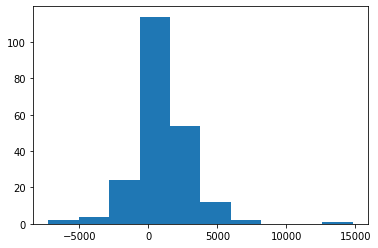

In [1793]:
plt.hist(df_cte_predict_by_lavka['predict']-df_cte_predict_by_lavka['count_orders'])

(array([55., 29., 42., 31., 24., 17.,  7.,  3.,  4.,  1.]),
 array([-39.16856614,   9.33981111,  57.84818836, 106.35656561,
        154.86494286, 203.37332011, 251.88169736, 300.39007461,
        348.89845186, 397.40682911, 445.91520636]),
 <BarContainer object of 10 artists>)

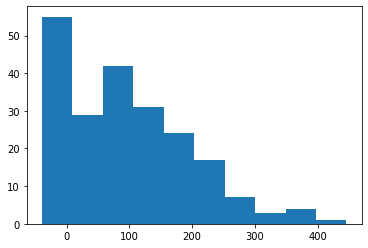

In [1795]:
plt.hist(df_cte_predict_by_lavka['cte_mean_x']-df_cte_predict_by_lavka['cte_fin_sec_weighted'], bins=10)

In [1802]:
df_cte_new_old_lavka['external_id'].nunique()

213

In [1807]:
df_cte_new_old_lavka = df_cte_new_old_lavka.merge(df_cte_predict_by_lavka, on='external_id')

In [1808]:
df_cte_new_old_lavka.columns

Index([           'external_id',       'best_hex_gid_new',
                'hex_gid_lavka',           'cte_mean_old',
                     'cte_mean', 'cte_fin_sec_weighted_x',
                   'diff_ratio',                   'rank',
                 'flg_same_hex',            'cte_fin_sec',
                'geometry_zone',       'month_order_left',
                              0,                   'diff',
                   'cte_mean_x', 'cte_fin_sec_weighted_y',
                      'predict',           'count_orders'],
      dtype='object')

In [1811]:
df_cte_lavka_predict = df_cte_new_old_lavka[
    [           'external_id',       'best_hex_gid_new',
                'hex_gid_lavka',           
                     'cte_mean', 
                  
                 'flg_same_hex',            'cte_fin_sec',
                'geometry_zone',       'month_order_left',
                              0,                   'diff',
                   'cte_fin_sec_weighted_y',
                      'predict',           'count_orders']
]

df_cte_lavka_predict= gf.get_gdf(df_cte_lavka_predict, 'geometry_zone',4326)

df_cte_lavka_predict.rename(columns={'diff':'diff_cte','cte_fin_sec_weighted_y':'cte_sec_predict','cte_min_fact':'cte_mean_fact',0:'hexs_in_zone','predict':'count_orders_predict'} , inplace=True)

df_cte_lavka_predict['diff_cte_predict']= df_cte_lavka_predict['cte_mean_fact']-df_cte_lavka_predict['cte_sec_predict']

df_cte_lavka_predict['diff_ratio'] = df_cte_lavka_predict['diff_cte_predict']/df_cte_lavka_predict['cte_mean_fact']

df_cte_lavka_predict['diff_orders_predict']=df_cte_lavka_predict['count_orders_predict'] = df_cte_lavka_predict['count_orders']

(array([1.2014e+04, 3.6900e+02, 4.6000e+01, 8.0000e+00, 0.0000e+00,
        0.0000e+00, 1.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+00]),
 array([   0. ,  756.8, 1513.6, 2270.4, 3027.2, 3784. , 4540.8, 5297.6,
        6054.4, 6811.2, 7568. ]),
 <BarContainer object of 10 artists>)

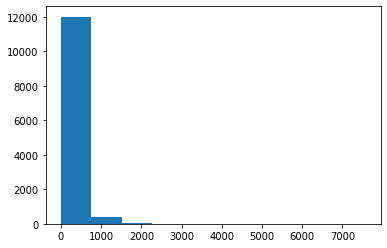

In [2154]:
plt.hist(gdf_orders_hex ['count_orders'])

In [2625]:
m1 = folium.Map([55.753637, 37.621179], zoom_start=11, attr='My Data Attribution')
  

transparetn_style = lambda feature: {'fillColor': 'gray','color': 'gray','weight': 0,'fillOpacity':0.00}


# folium.Choropleth(geo_data=df_cte_lavka_predict[['external_id','geometry_zone']],
#              data=df_cte_lavka_predict,
#              name='potential diff_ratio',
#              columns=['external_id','diff_ratio'],
#              key_on='feature.properties.external_id',
#              method='quantile',
#              bins=8,
# #                  bins=bins,
#              fill_color='Greens', fill_opacity=0.7, line_opacity=0,
#              legend_name='potential diff_ratio',
             
#              show=True
                   
# #                  popup_hover = 'count_orders_hex_day'
# #                  ,tooltip=html
# #              highlight=True
#             ).add_to(m1)

bins=gdf_orders_hex['count_orders'].quantile([0,0.2,0.4, 0.5,0.8,1 ])

folium.Choropleth(geo_data=gdf_orders_hex [['hex_gid','count_orders','geometry']],
             data=gdf_orders_hex,
             name='may fact orders',
             columns=['hex_gid','count_orders'],
             key_on='feature.properties.hex_gid',
#              method='equals',
             bins=bins,
#                  bins=bins,
             fill_color='Greens', fill_opacity=0.7, line_opacity=0,
             legend_name='current orders',
             
             show=True,
#                  popup_hover = 'count_orders_hex_day'
#                  ,tooltip=html
#              highlight=True
            ).add_to(m1)





folium.Choropleth(geo_data=df_cte_lavka_predict[['external_id','geometry_zone']],
             data=df_cte_lavka_predict,
             name='current cte mean',
             columns=['external_id','cte_mean_fact'],
             key_on='feature.properties.external_id',
             method='quantile',
             bins=8,
#                  bins=bins,
             fill_color='Reds', fill_opacity=0.7, line_opacity=0,
             legend_name='current cte mean',
             
             show=False,
#                  popup_hover = 'count_orders_hex_day'
#                  ,tooltip=html
#              highlight=True
            ).add_to(m1)


folium.Choropleth(geo_data=df_best_hex_coverage[['hex_gid','geometry']],
             data=df_best_hex_coverage,
             name='ttl_pop_res',
             columns=['hex_gid','C1C2_res_6m'],
             key_on='feature.properties.hex_gid',
             method='quantile',
             bins=8,
#                  bins=bins,
             fill_color='Reds', fill_opacity=0.7, line_opacity=0,
             legend_name='C1C2_res_cte=15min',
             
             show=True,
#                  popup_hover = 'count_orders_hex_day'
#                  ,tooltip=html
#              highlight=True
            ).add_to(m1)


# folium.Choropleth(geo_data=df_cte_lavka_predict[['external_id','geometry_zone']],
#              data=df_cte_lavka_predict,
#              name='potential cte improvement',
#              columns=['external_id','diff_cte_predict'],
#              key_on='feature.properties.external_id',
#              method='quantile',
#              bins=8,
# #                  bins=bins,
#              fill_color='Blues', fill_opacity=0.7, line_opacity=0,
#              legend_name='potential cte improvement',
             
#              show=True,
# #                  popup_hover = 'count_orders_hex_day'
# #                  ,tooltip=html
# #              highlight=True
#             ).add_to(m1)

# folium.Choropleth(geo_data=df_cte_lavka_predict[['external_id','geometry_zone']],
#              data=df_cte_lavka_predict,
#              name='potential orders growth',
#              columns=['external_id','diff_orders_predict'],
#              key_on='feature.properties.external_id',
#              method='quantile',
#              bins=8,
# #                  bins=bins,
#              fill_color='YlGn', fill_opacity=0.7, line_opacity=0,
#              legend_name='potential orders growth',
             
#              show=True,
# #                  popup_hover = 'count_orders_hex_day'
# #                  ,tooltip=html
# #              highlight=True
#             ).add_to(m1)



layer1 = folium.GeoJson(
    df_cte_lavka_predict[['geometry_zone','external_id','diff_ratio','diff_orders_predict','diff_cte_predict','cte_mean_fact']],
    name='lavka_zones',
    style_function=lambda feature: {
        'color' : 'black',
        'weight' : 1,
        'fillOpacity' : 0.0,
        },
     tooltip=folium.features.GeoJsonTooltip(
                fields=['external_id',
#                         'diff_ratio','diff_orders_predict','diff_cte_predict',
                        'cte_mean_fact'
                       ],
                aliases=['лавка id',
#                          'diff_ratio','diff_orders_predict','diff_cte_predict',
                         'cte_mean fact'
                      ],
                style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;") )
    ).add_to(m1)

# layer = folium.GeoJson(
#     df_best_hex[['hex_gid','geometry']],
#     name='recommended place',
    
#     marker=folium.Marker(icon = folium.Icon(color="green")),
#     style_function=lambda feature: {
#         'color' : 'black',
#         'weight' : 1,
#         'fillOpacity' : 0.0,
#         },
#      tooltip=folium.features.GeoJsonTooltip(
#                 fields=['external_id'
#                        ],
#                 aliases=['лавка id'
#                       ],
#                 style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;") )
#     ).add_to(m1)


layer0 = folium.GeoJson(
   gdf_best_hex[['geometry','hex_gid']],
    name='best location according to the model',
    style_function=lambda feature: {
        'color' : 'blue',
        'weight' : 2,
        'fillOpacity' : 0.3,
        },
     tooltip=folium.features.GeoJsonTooltip(
                fields=['hex_gid'
                       ],
                aliases=['hex_gid'
                      ],
                style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;") )
    ).add_to(m1)



layer3 = folium.GeoJson(
   df_best_hex_coverage[['geometry','hex_gid']],
    name='hexs',
    style_function=lambda feature: {
        'color' : 'blue',
        'weight' : 0,
        'fillOpacity' : 0.0,
        },
     tooltip=folium.features.GeoJsonTooltip(
                fields=['hex_gid'
                       ],
                aliases=['hex_gid'
                      ],
                style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;") )
    ).add_to(m1)




layer2 = folium.GeoJson(
   df_lavka_stores_apr[['geometry_store','address']],
    name='current stores',
    style_function=lambda feature: {
        'color' : 'black',
        'weight' : 1,
        'fillOpacity' : 0.0,
        }
    ).add_to(m1)



folium.LayerControl(collapsed=False).add_to(m1)
m1

In [2624]:
m1.save('map2cte_moscow.html')

In [2164]:
df_best_hex_coverage.columns

Index(['external_id', 'hex_gid', 'C1C2_res_500', 'C1C2_res_500_no_borders',
       'C1C2_res_1000', 'C1C2_res_1000_no_borders', 'rank_within_zone',
       'lavka_id', 'lavka_slug', 'hex_coverage_rank_percent',
       'diff_best_within_zone', 'diff_best_no_borders', 'lat', 'long',
       'C1C2_res_6m_no_borders', 'C1C2_res_6m', 'C1C2_res_12m_no_borders',
       'C1C2_res_12m', 'C1C2_res', 'lavka_exist_month', 'count_orders_sum',
       'geometry'],
      dtype='object')

In [2162]:
m1.save('map_fact_and recommendation.html')

In [2161]:
m1.save('map_mean_cte_improvement_zones.html')

In [ ]:
df_cte_new_old_lavka